## Sim Demo

### Imports

In [8]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [9]:
from env.imports import *

In [10]:
# overall imports
import importlib
import data

# importlib.reload(data.data_utils)
# importlib.reload(data.data_load)
# importlib.reload(sim.sim)
# importlib.reload(sim.sim_utils)

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

#### Check job specs

In [11]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 18.3%
RAM Usage: 11.6%
Available RAM: 890.0G
Total RAM: 1007.0G
52.4G


In [12]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))
os.environ["CUDA_VISIBLE_DEVICES"] = "0,1"

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


0,1
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.00 GB


In [13]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  0% |


In [14]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

#### Simulation tests <a id="sims"></a>

Number of components for 95% variance PCA: 105
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (390, 7380)
X_pca shape: (390, 105)
Y_sc shape: (390, 390)
Y_sc_spectralL shape: (390, 455)
Y_sc_spectralA shape: (390, 456)
Y_fc shape: (390, 390)
Coordinates shape: (390, 3)
Y shape (390, 390)
feature_name:  euclidean
processing_type:  None
features ['euclidean']
X generated... expanding to pairwise dataset


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 6, 'binarize': False}
Number of learnable parameters in MLP: 35585
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0240
Best val loss so far at epoch 2: 0.0212
Best val loss so far at epoch 4: 0.0206
Epoch 5/100, Train Loss: 0.0209, Val Loss: 0.0219
Best val loss so far at epoch 6: 0.0201
Epoch 10/100, Train Loss: 0.0188, Val Loss: 0.0205
Best val loss so far at epoch 11: 0.0199
Best val loss so far at epoch 13: 0.0198
Best val loss so far at epoch 14: 0.0193
Epoch 15/100, Train Loss: 0.0177, Val Loss: 0.0195
Best val loss so far at epoch 18: 0.0185
Epoch 20/100, Train Loss: 0.0168, Val Loss: 0.0189
Best val loss so far at epoch 21: 0.0183
Best val loss so far at epoch 23: 0.0182
Epoch 25/100, Train Loss: 0.0162, Val Loss: 0.0185
Best val loss so far at epoch 27: 0.0181
Epoch 30/100, Train Loss: 0.0155, Val Loss: 0.0191
Epoch 35/100, Train Loss: 0.0152, Val Loss: 0.0188

LR REDUCED: 0.001000 →

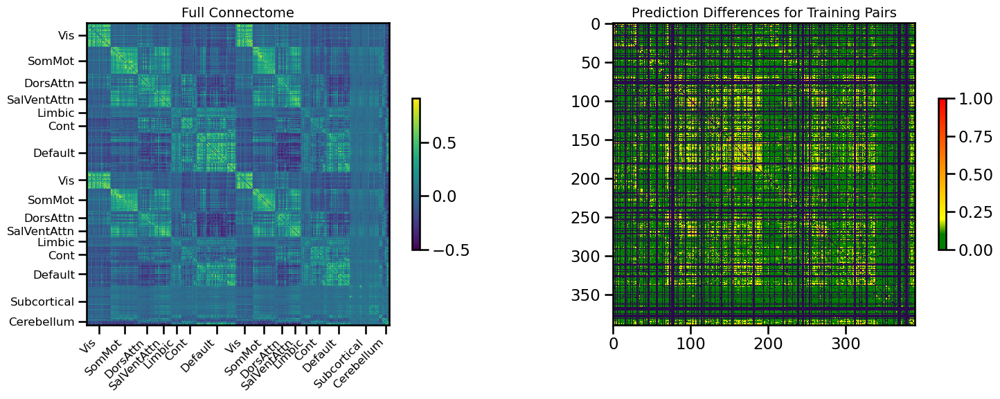

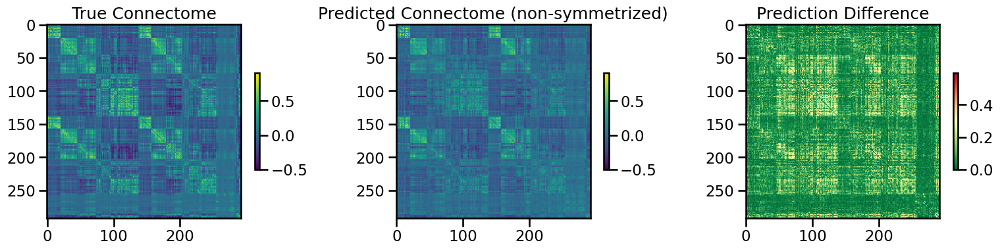

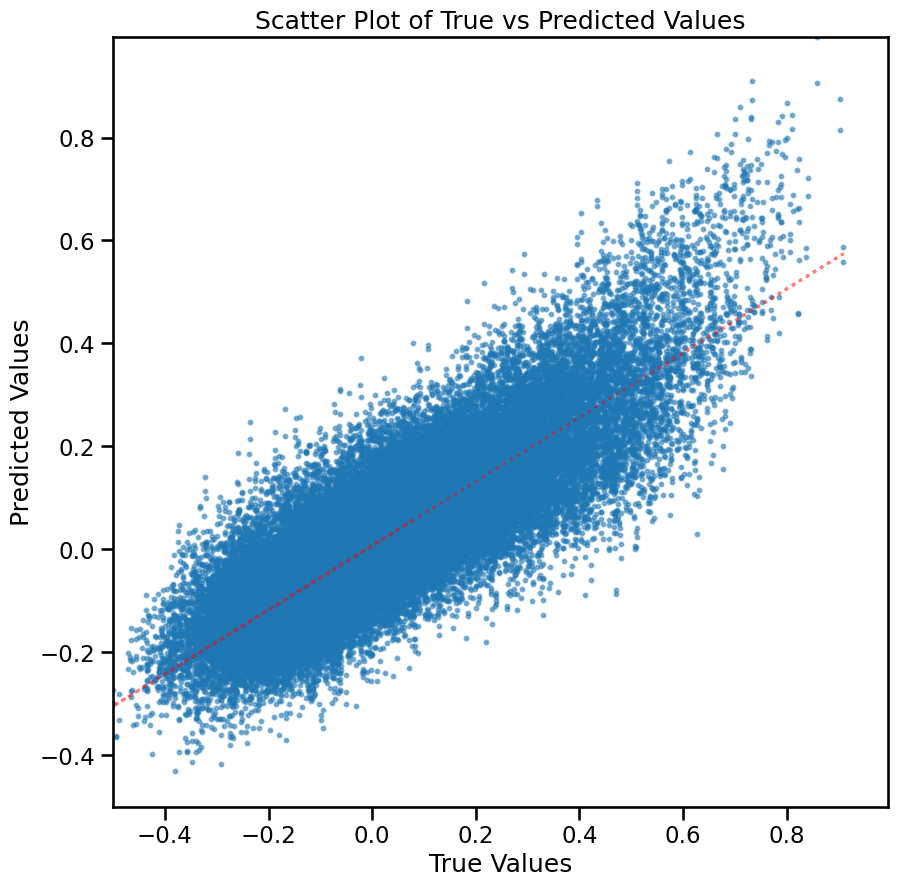

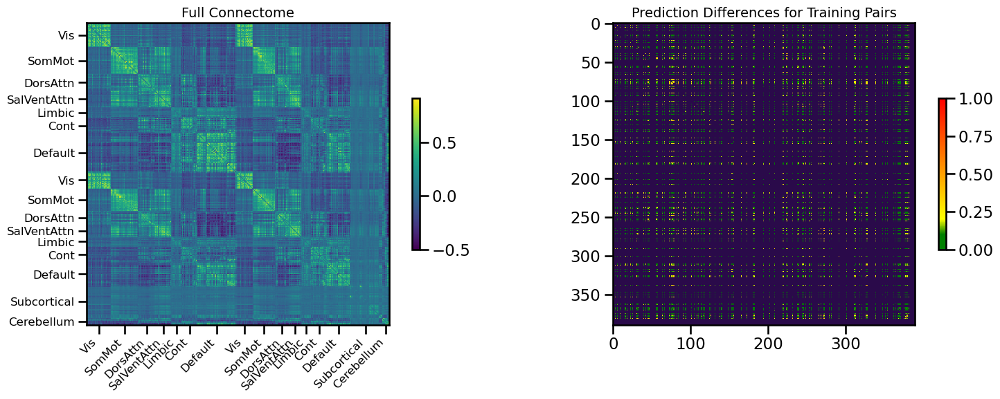

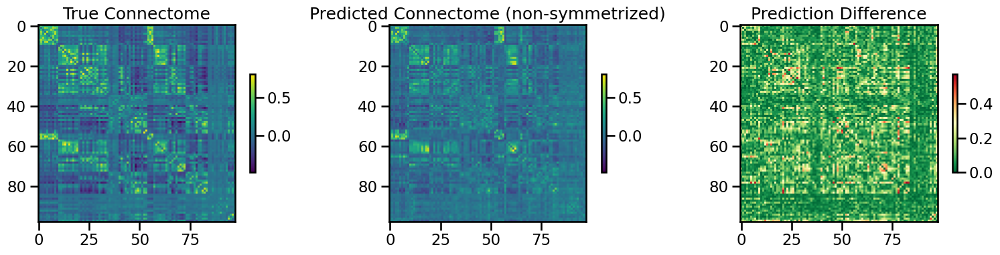

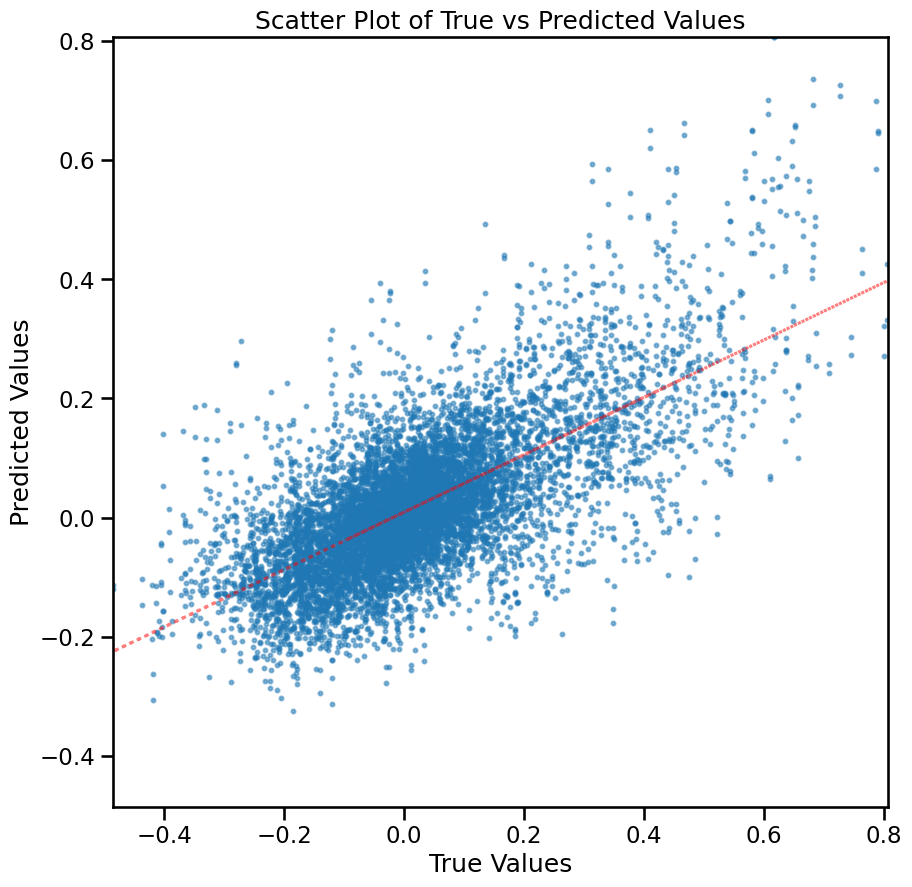


TRAIN METRICS: {'mse': 0.010457133, 'mae': 0.074808985, 'r2': 0.6851576515972093, 'pearson_corr': 0.8318691402603364, 'geodesic_distance': 20.443609736156603}
TEST METRICS: {'mse': 0.016032811, 'mae': 0.09280386, 'r2': 0.47158125768142756, 'pearson_corr': 0.6869608585237341, 'geodesic_distance': 12.766290080433247}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 6, 'binarize': False, 'dropout_rate': 0.0, 'learning_rate': 0.001, 'weight_decay': 0.0, 'batch_size': 64, 'epochs': 100}


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 6, 'binarize': False}
Number of learnable parameters in MLP: 35585
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0264
Best val loss so far at epoch 2: 0.0249
Best val loss so far at epoch 3: 0.0245
Best val loss so far at epoch 4: 0.0243
Epoch 5/100, Train Loss: 0.0205, Val Loss: 0.0228
Best val loss so far at epoch 5: 0.0228
Epoch 10/100, Train Loss: 0.0184, Val Loss: 0.0222
Best val loss so far at epoch 10: 0.0222
Best val loss so far at epoch 12: 0.0216
Best val loss so far at epoch 14: 0.0214
Epoch 15/100, Train Loss: 0.0171, Val Loss: 0.0216
Best val loss so far at epoch 17: 0.0213
Best val loss so far at epoch 18: 0.0211
Epoch 20/100, Train Loss: 0.0164, Val Loss: 0.0209
Best val loss so far at epoch 20: 0.0209
Best val loss so far at epoch 23: 0.0207
Epoch 25/100, Train Loss: 0.0158, Val Loss: 0.0211

LR REDUCED: 0.001000 → 0.000300 at Val Loss: 0.020756
Best val loss so far at epoch 

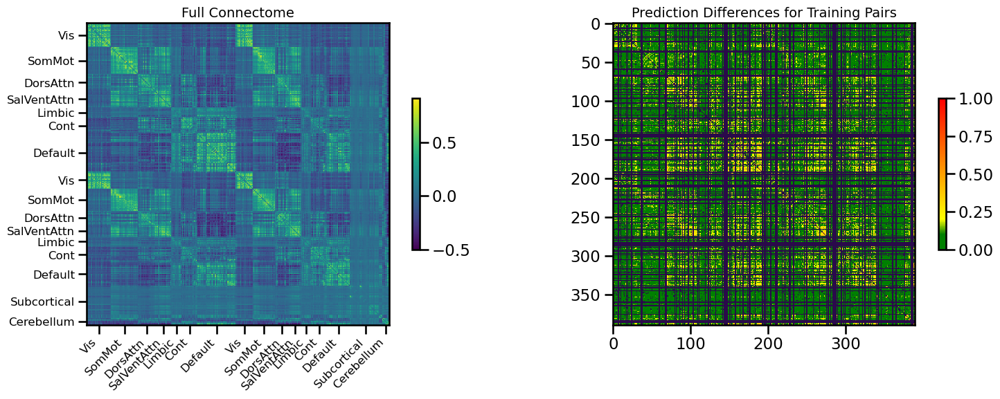

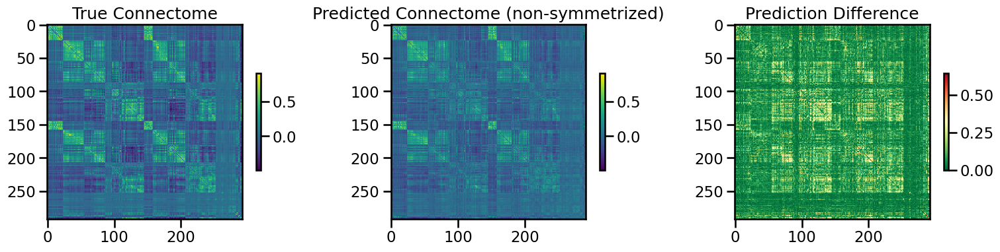

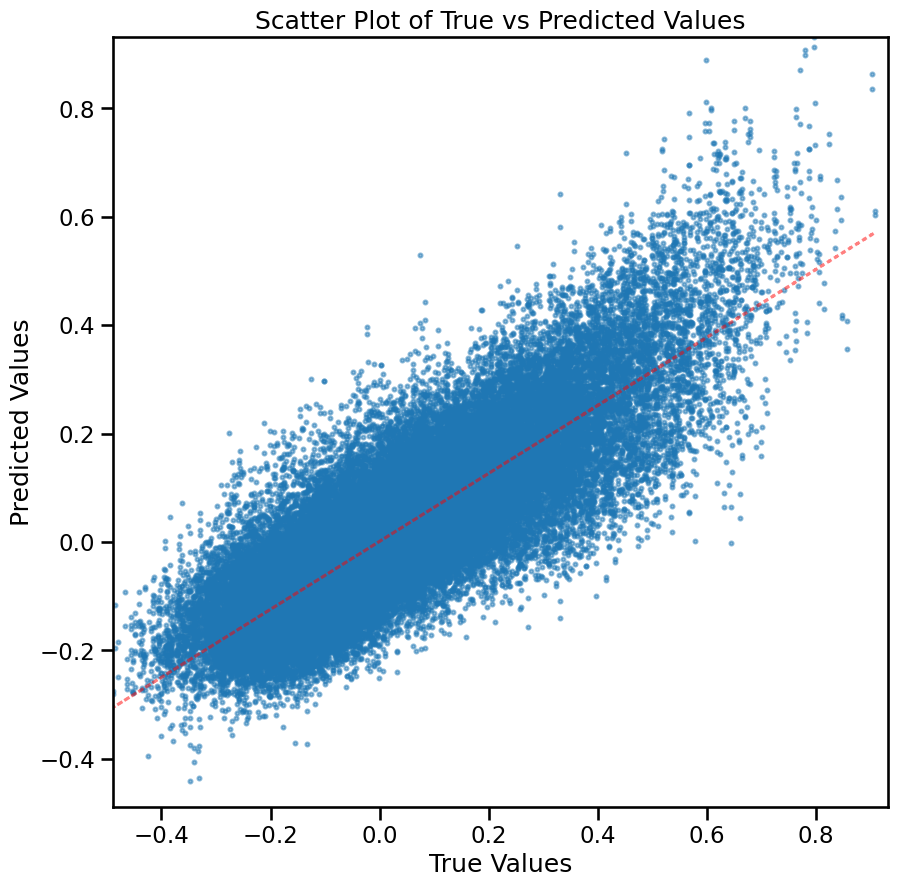

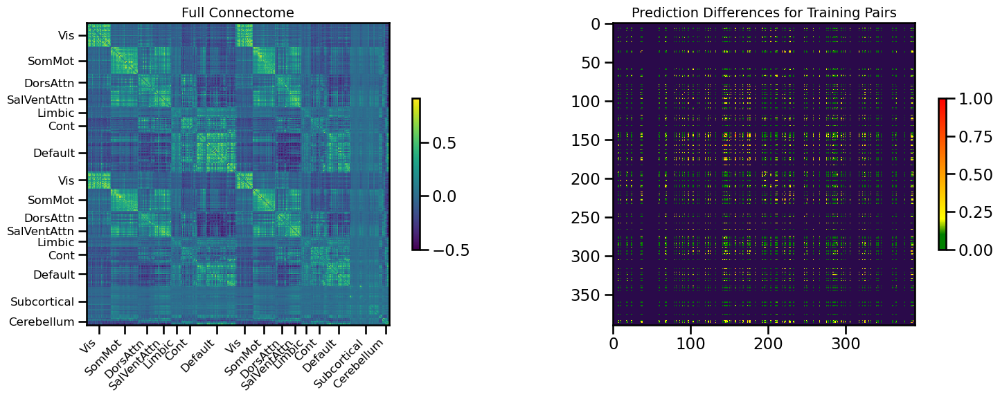

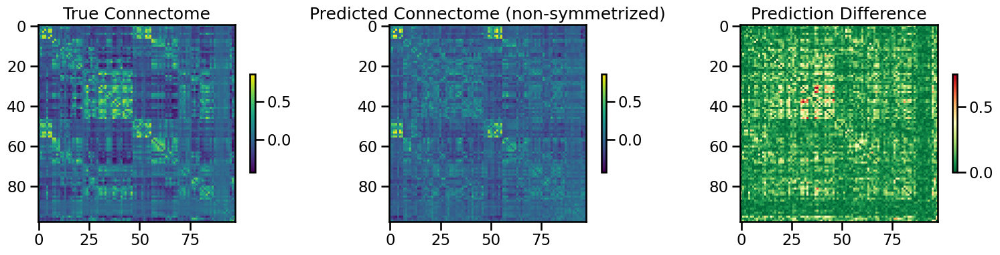

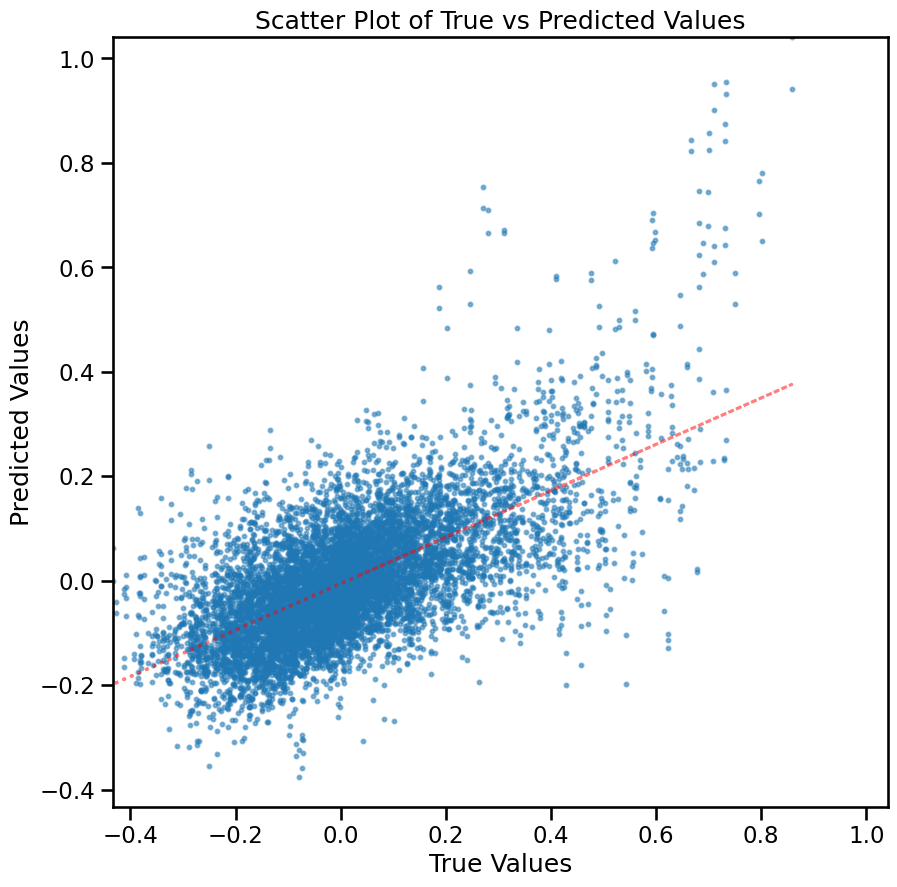


TRAIN METRICS: {'mse': 0.01056375, 'mae': 0.07484619, 'r2': 0.6793057592350429, 'pearson_corr': 0.8278432841718277, 'geodesic_distance': 20.879990090225217}
TEST METRICS: {'mse': 0.018519787, 'mae': 0.0999089, 'r2': 0.4166288507905629, 'pearson_corr': 0.649682011923449, 'geodesic_distance': 12.363202057487612}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 6, 'binarize': False, 'dropout_rate': 0.0, 'learning_rate': 0.001, 'weight_decay': 0.0, 'batch_size': 64, 'epochs': 100}


  warnings.warn(



1
2
4
BEST CONFIG {'input_dim': 6, 'binarize': False}
Number of learnable parameters in MLP: 35585
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0239
Best val loss so far at epoch 2: 0.0228
Best val loss so far at epoch 3: 0.0219
Epoch 5/100, Train Loss: 0.0213, Val Loss: 0.0217
Best val loss so far at epoch 5: 0.0217
Best val loss so far at epoch 6: 0.0204
Best val loss so far at epoch 9: 0.0200
Epoch 10/100, Train Loss: 0.0191, Val Loss: 0.0200
Best val loss so far at epoch 12: 0.0191
Epoch 15/100, Train Loss: 0.0178, Val Loss: 0.0186
Best val loss so far at epoch 15: 0.0186
Best val loss so far at epoch 16: 0.0184
Best val loss so far at epoch 19: 0.0183
Epoch 20/100, Train Loss: 0.0169, Val Loss: 0.0183
Best val loss so far at epoch 20: 0.0183
Epoch 25/100, Train Loss: 0.0162, Val Loss: 0.0183
Best val loss so far at epoch 25: 0.0183
Best val loss so far at epoch 26: 0.0178
Epoch 30/100, Train Loss: 0.0158, Val Loss: 0

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



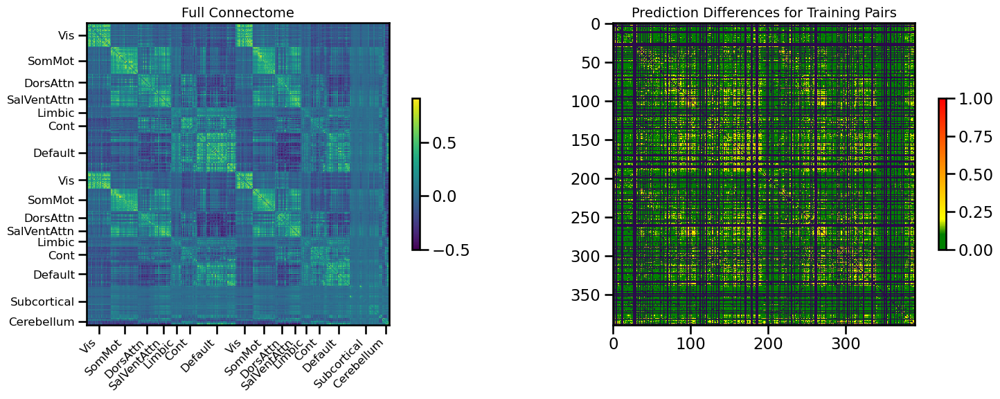

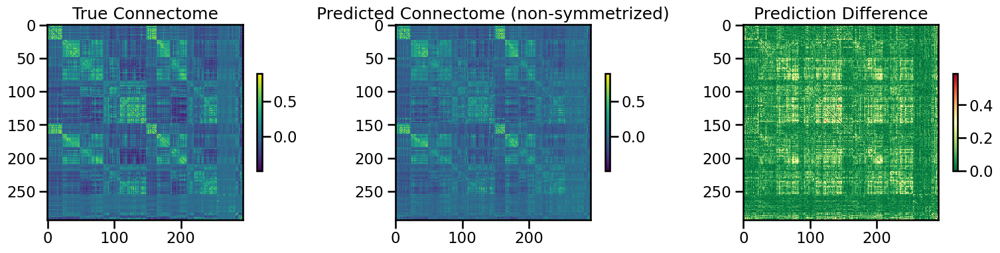

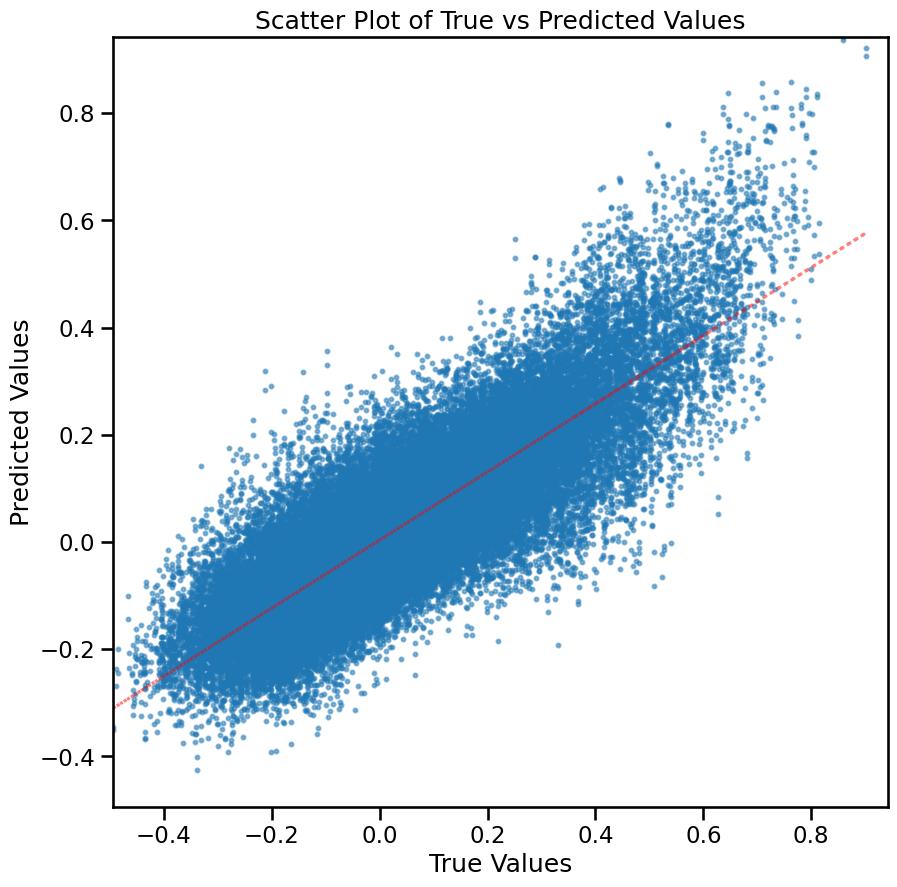

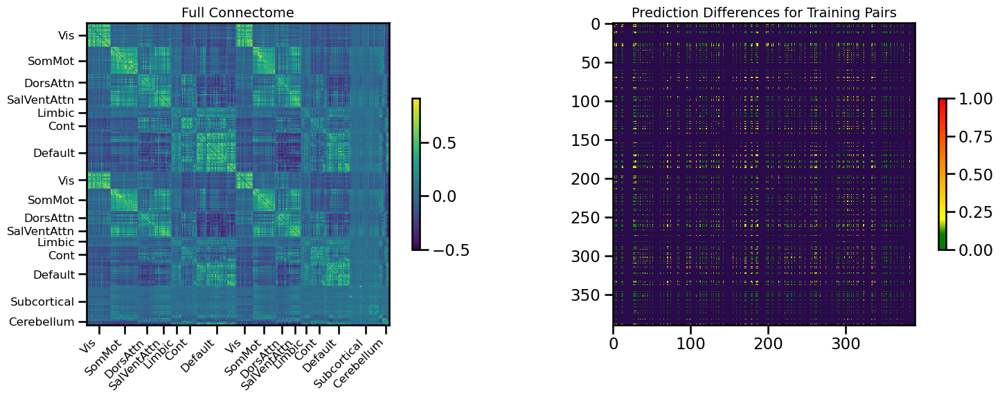

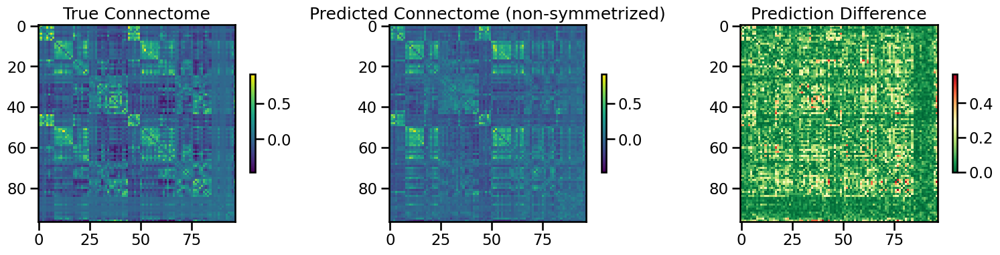

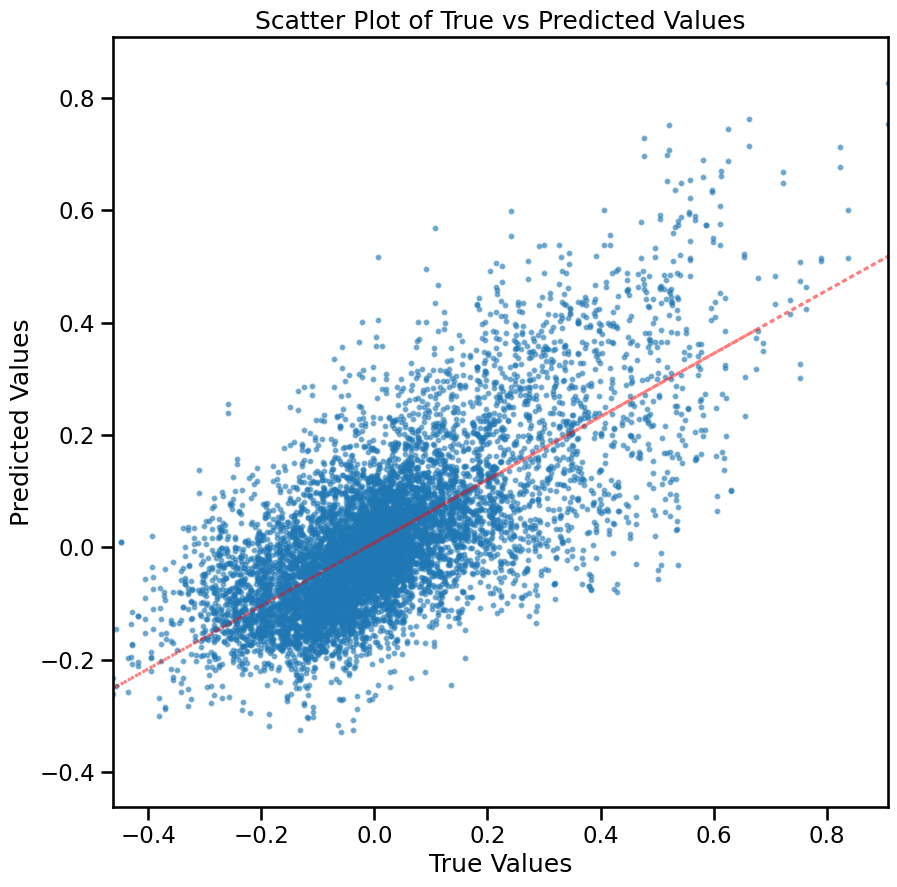


TRAIN METRICS: {'mse': 0.010180226, 'mae': 0.07421656, 'r2': 0.6899601699451808, 'pearson_corr': 0.8338186218477138, 'geodesic_distance': 20.228850524127207}
TEST METRICS: {'mse': 0.015952207, 'mae': 0.0926921, 'r2': 0.4843289349653003, 'pearson_corr': 0.7026090499388797, 'geodesic_distance': 11.950415472613608}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 6, 'binarize': False, 'dropout_rate': 0.0, 'learning_rate': 0.001, 'weight_decay': 0.0, 'batch_size': 64, 'epochs': 100}


  warnings.warn(



1
2
3
BEST CONFIG {'input_dim': 6, 'binarize': False}
Number of learnable parameters in MLP: 35585
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0277
Best val loss so far at epoch 2: 0.0270
Best val loss so far at epoch 3: 0.0259
Best val loss so far at epoch 4: 0.0235
Epoch 5/100, Train Loss: 0.0208, Val Loss: 0.0232
Best val loss so far at epoch 5: 0.0232
Best val loss so far at epoch 6: 0.0229
Best val loss so far at epoch 7: 0.0224
Best val loss so far at epoch 8: 0.0221
Epoch 10/100, Train Loss: 0.0184, Val Loss: 0.0237
Best val loss so far at epoch 12: 0.0220
Best val loss so far at epoch 13: 0.0215
Epoch 15/100, Train Loss: 0.0171, Val Loss: 0.0221
Best val loss so far at epoch 18: 0.0207
Epoch 20/100, Train Loss: 0.0164, Val Loss: 0.0220
Best val loss so far at epoch 22: 0.0203
Best val loss so far at epoch 24: 0.0196
Epoch 25/100, Train Loss: 0.0157, Val Loss: 0.0217
Epoch 30/100, Train Loss: 0.0153, Val Loss: 0.0

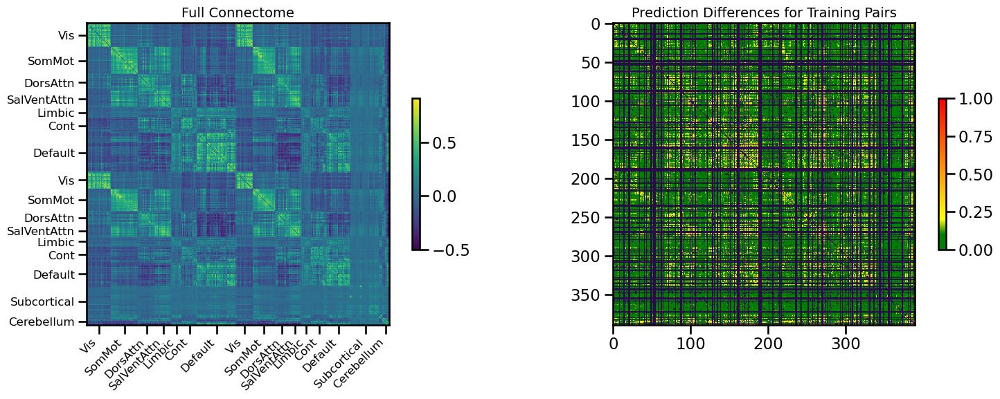

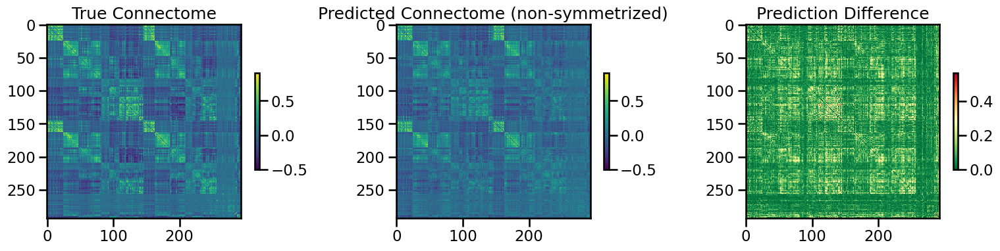

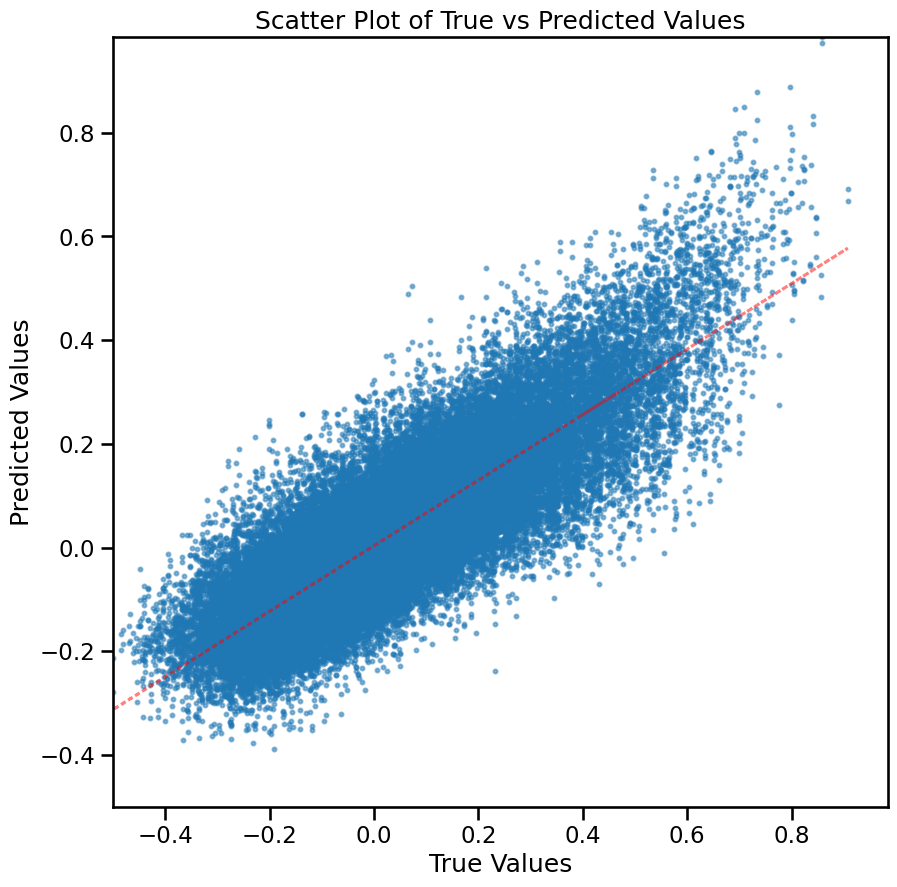

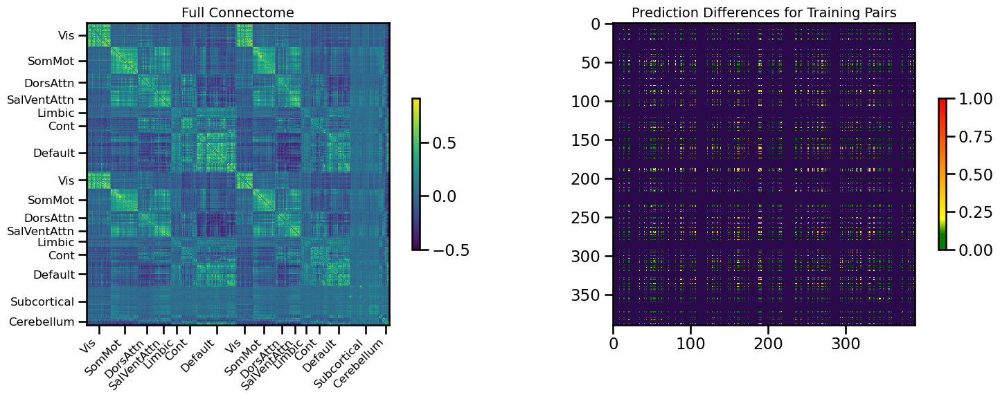

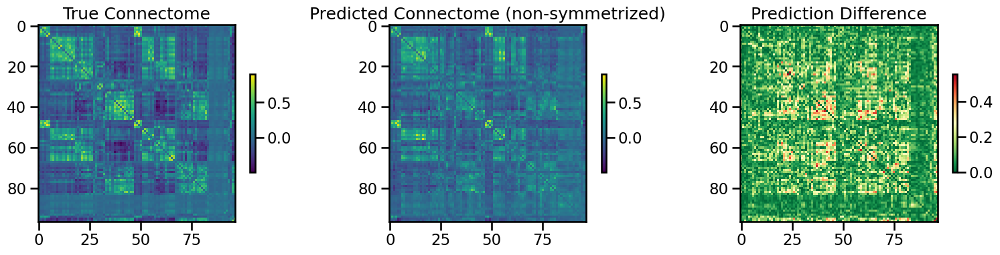

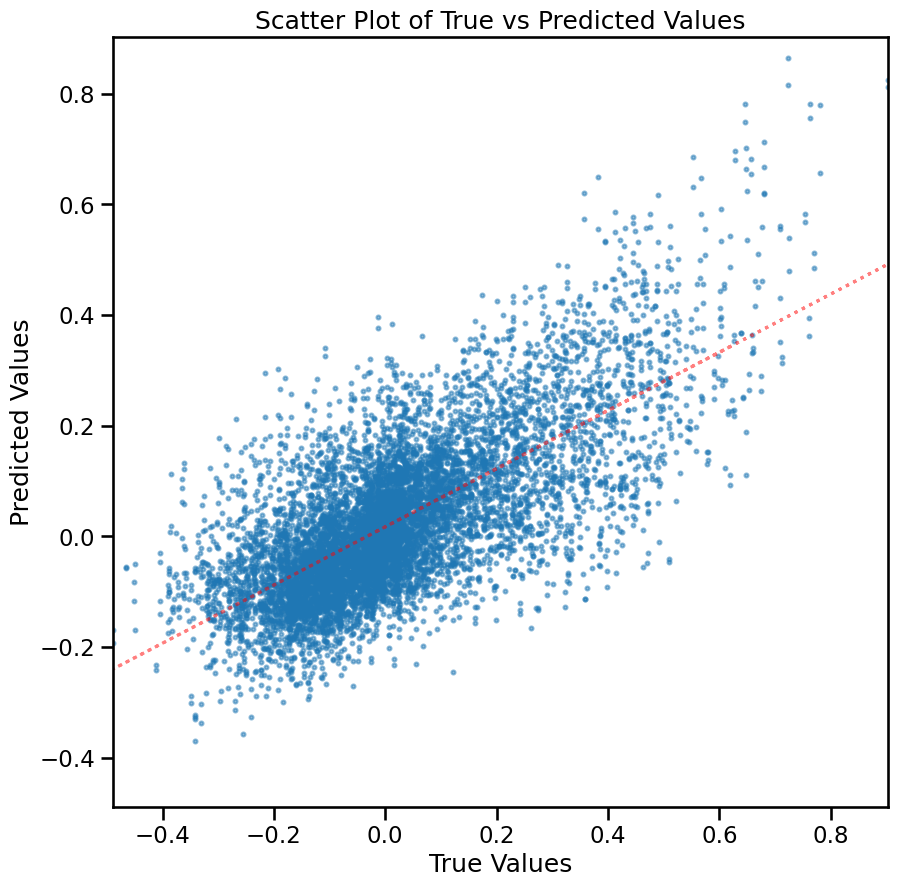


TRAIN METRICS: {'mse': 0.009920248, 'mae': 0.07272253, 'r2': 0.6866655973021234, 'pearson_corr': 0.8319108782174248, 'geodesic_distance': 19.227365566833}
TEST METRICS: {'mse': 0.017883334, 'mae': 0.09908501, 'r2': 0.4966625738158531, 'pearson_corr': 0.7072845307149052, 'geodesic_distance': 13.195329709998832}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 6, 'binarize': False, 'dropout_rate': 0.0, 'learning_rate': 0.001, 'weight_decay': 0.0, 'batch_size': 64, 'epochs': 100}
CPU Usage: 19.3%
RAM Usage: 12.6%
Available RAM: 879.7G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |


110477

In [10]:
# Run simulation
single_sim_run(
              cv_type='random',
              random_seed=42,
              model_type='dynamic_mlp',
              feature_type=[{'euclidean': None}],
              connectome_target='FC',
              binarize=False,
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 3),
              save_sim=False,
              track_wandb=False,
              skip_cv=True
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 105
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (390, 7380)
X_pca shape: (390, 105)
Y_sc shape: (390, 390)
Y_sc_spectralL shape: (390, 455)
Y_sc_spectralA shape: (390, 456)
Y_fc shape: (390, 390)
Coordinates shape: (390, 3)
Y shape (390, 390)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin


2
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'hidden_dims': [256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}


  warnings.warn(



Number of learnable parameters in MLP: 3812609
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.01 GB
Best val loss so far at epoch 1: 0.0418
Best val loss so far at epoch 2: 0.0342
Best val loss so far at epoch 3: 0.0296
Best val loss so far at epoch 4: 0.0275
Epoch 5/100, Train Loss: 0.0628, Val Loss: 0.0271
Best val loss so far at epoch 5: 0.0271
Best val loss so far at epoch 7: 0.0254
Best val loss so far at epoch 8: 0.0246
Epoch 10/100, Train Loss: 0.0255, Val Loss: 0.0264
Epoch 15/100, Train Loss: 0.0127, Val Loss: 0.0262
Epoch 20/100, Train Loss: 0.0091, Val Loss: 0.0297
Best val loss so far at epoch 23: 0.0243
Epoch 25/100, Train Loss: 0.0076, Val Loss: 0.0275

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.026324
Epoch 30/100, Train Loss: 0.0059, Val Loss: 0.0244
Epoch 35/100, Train Loss: 0.0056, Val Loss: 0.0246
Epoch 40/100, Train Loss: 0.0054, Val Loss: 0.0239
Best val loss so far at epoch 40: 0.0239
Epoch 45/100, Train Loss: 0.0052, Val Loss: 0.0250

LR

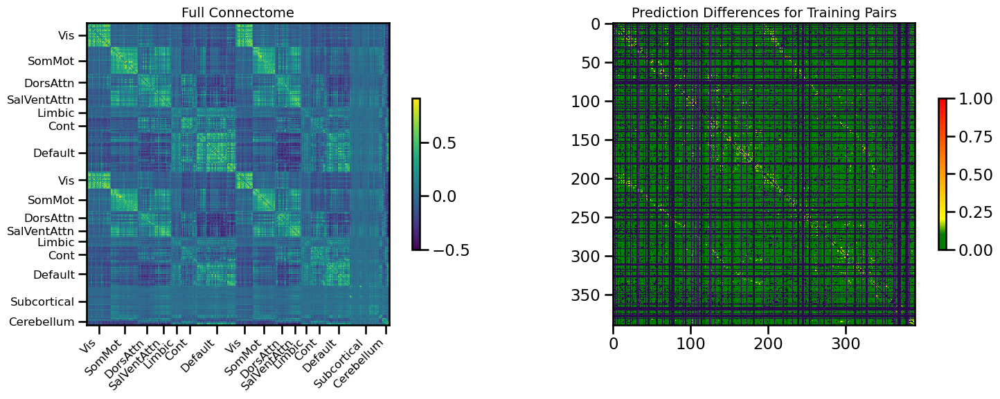

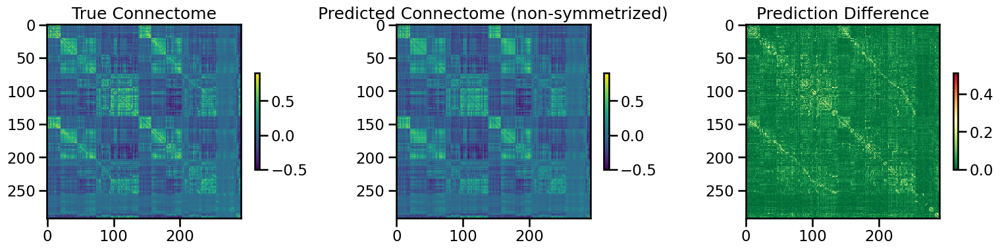

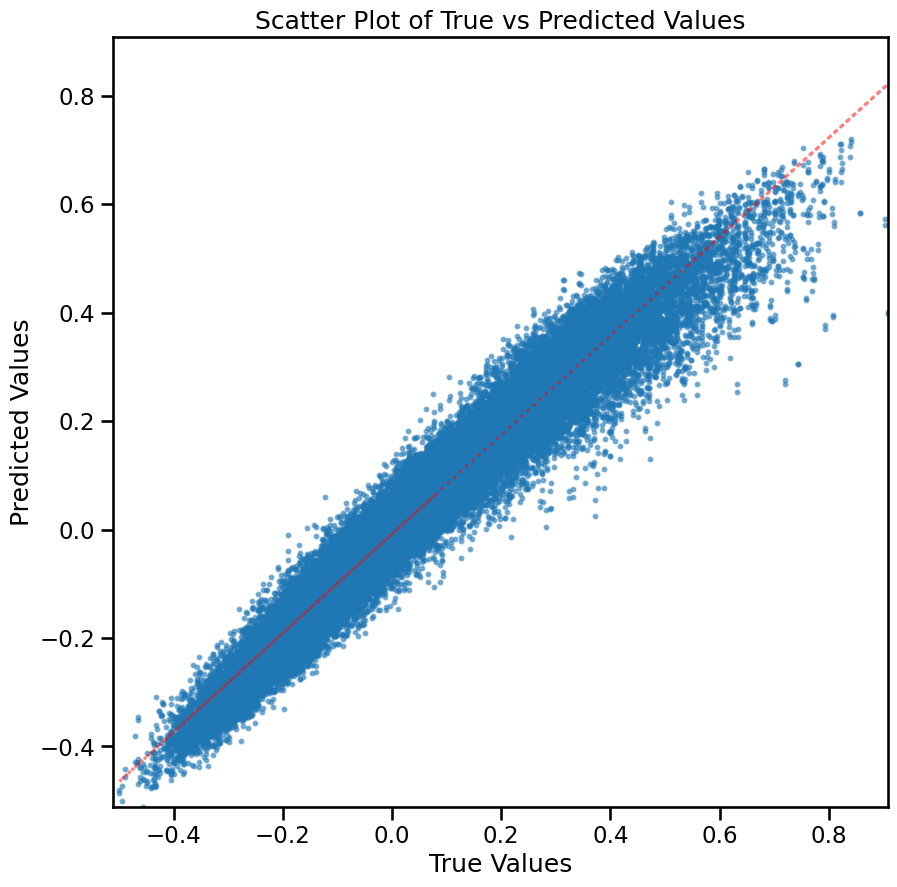

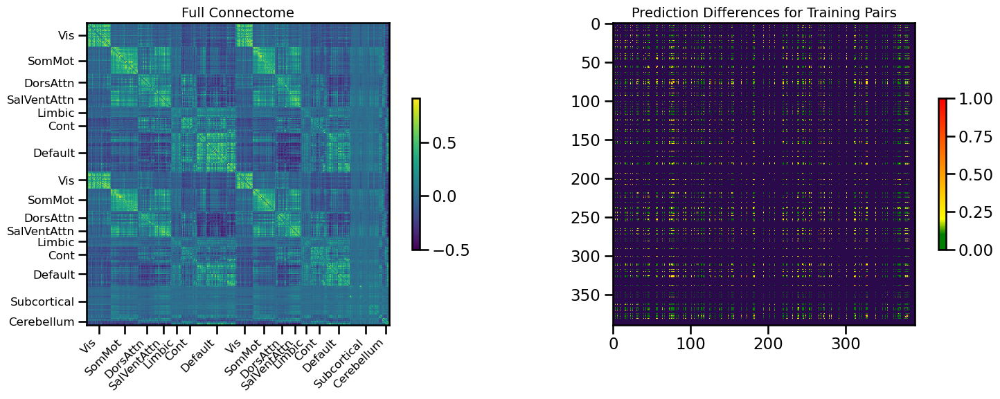

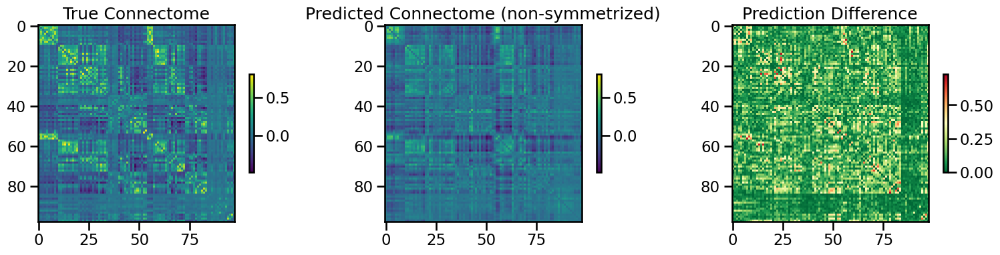

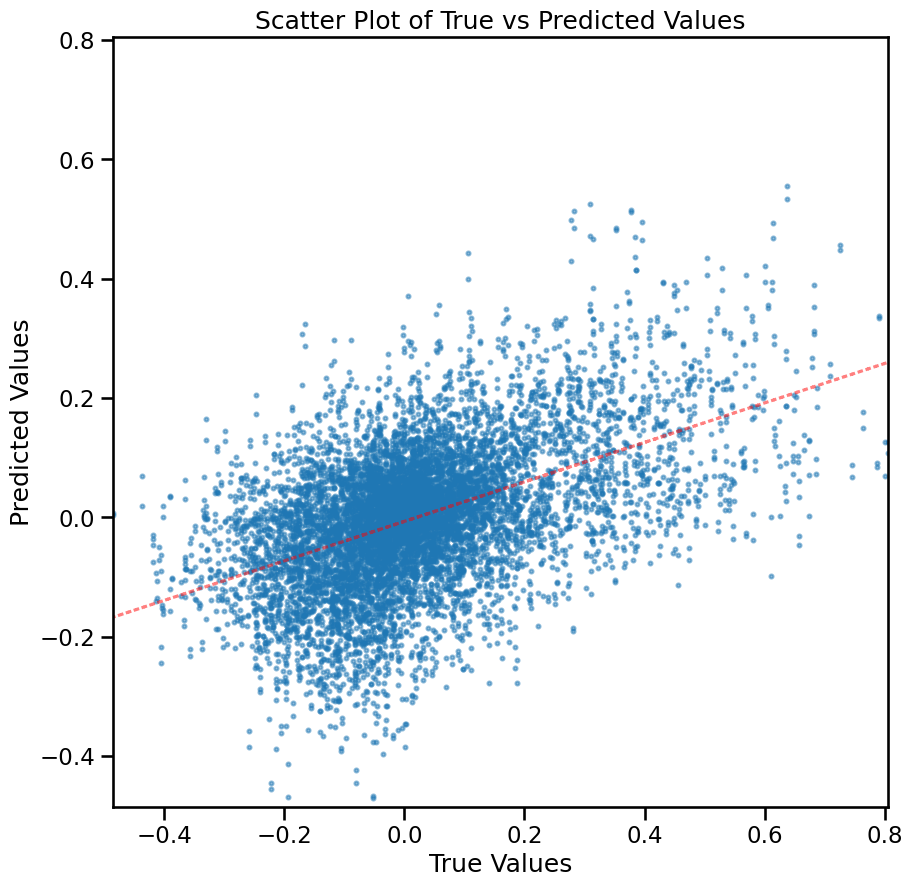


TRAIN METRICS: {'mse': 0.0019748204, 'mae': 0.031334367, 'r2': 0.9405422954732763, 'pearson_corr': 0.9717079210656434, 'geodesic_distance': 17.634791798285608}
TEST METRICS: {'mse': 0.024457747, 'mae': 0.11638563, 'r2': 0.19390723868069537, 'pearson_corr': 0.49159051484809846, 'geodesic_distance': 15.599611808831797}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14760, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100}


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'hidden_dims': [256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}
Number of learnable parameters in MLP: 3812609
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.0343
Best val loss so far at epoch 2: 0.0322
Best val loss so far at epoch 3: 0.0309
Best val loss so far at epoch 4: 0.0284
Epoch 5/100, Train Loss: 0.0469, Val Loss: 0.0288
Best val loss so far at epoch 6: 0.0263
Epoch 10/100, Train Loss: 0.0175, Val Loss: 0.0249
Best val loss so far at epoch 10: 0.0249
Epoch 15/100, Train Loss: 0.0101, Val Loss: 0.0338
Epoch 20/100, Train Loss: 0.0078, Val Loss: 0.0282
Epoch 25/100, Train Loss: 0.0067, Val Loss: 0.0278
Epoch 30/100, Train Loss: 0.0059, Val Loss: 0.0284

Early stopping triggered at epoch 30. Restoring best model with Val Loss: 0.0249


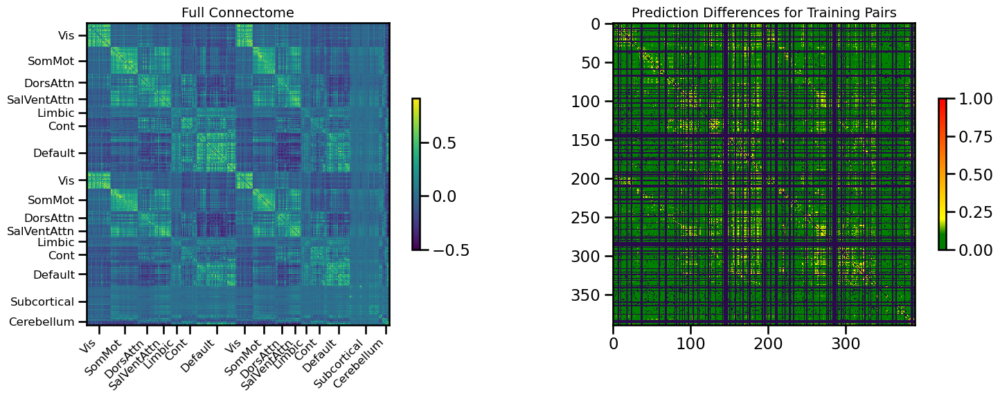

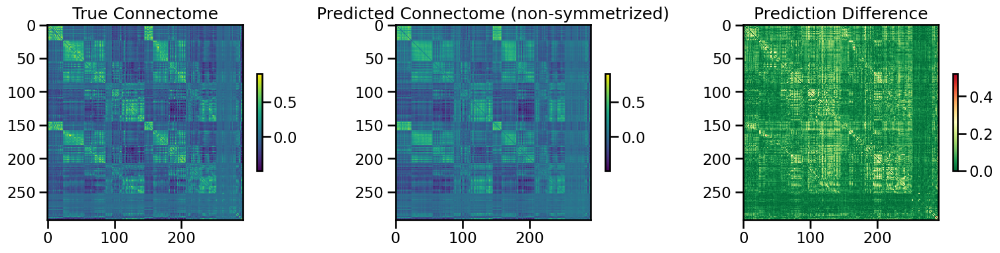

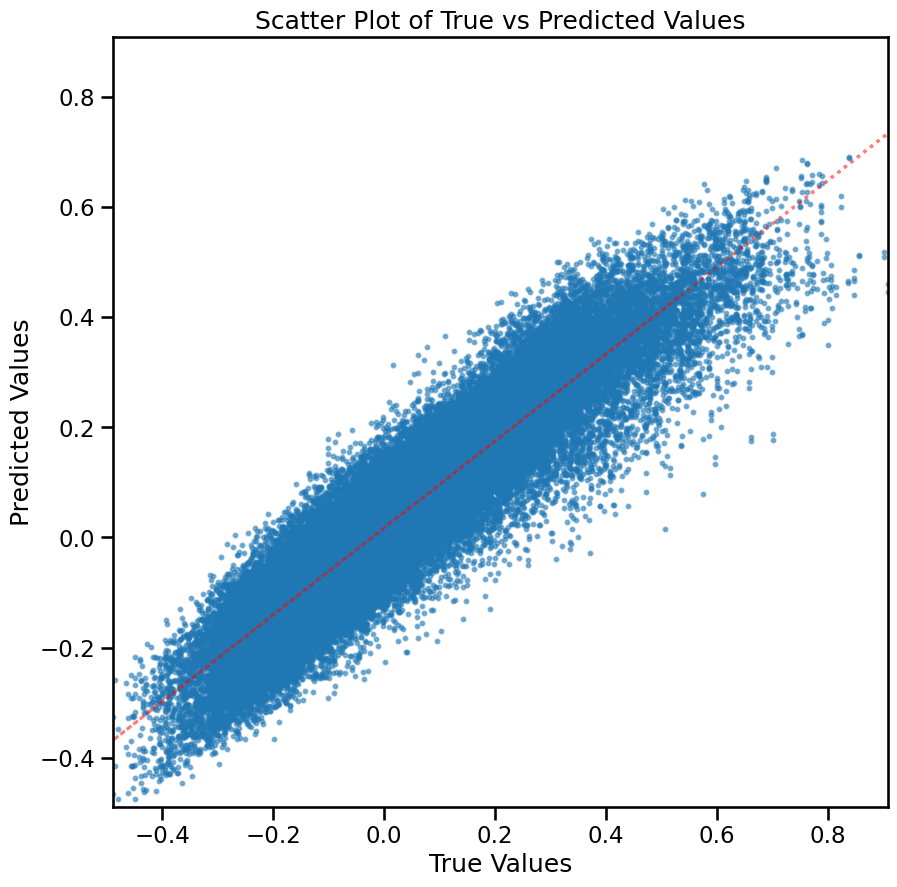

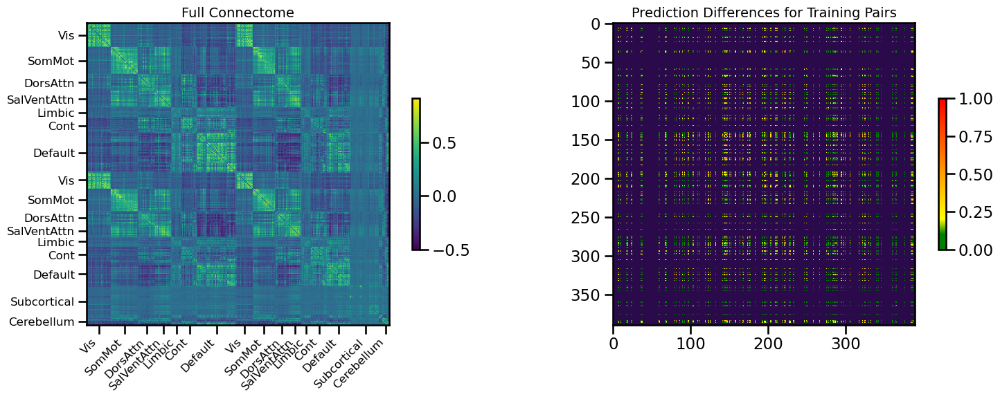

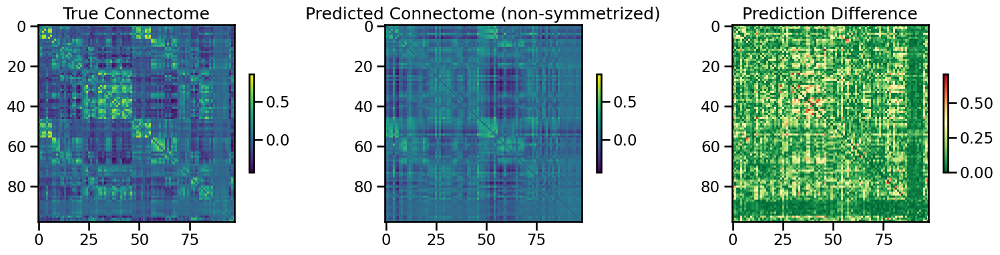

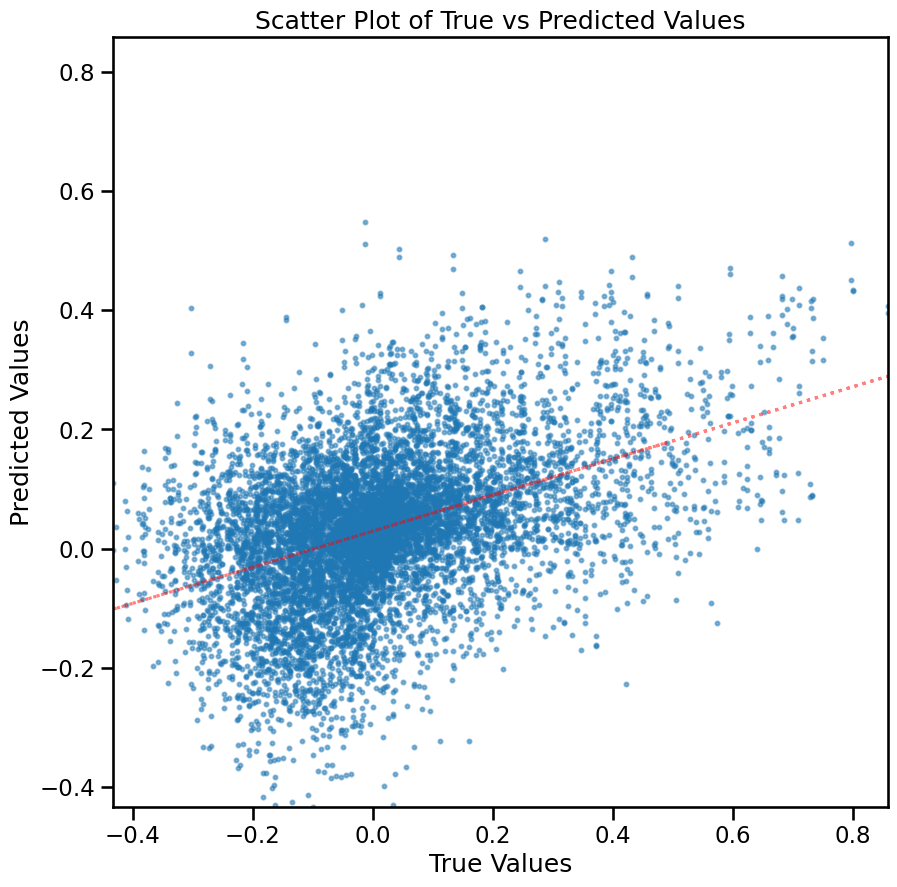


TRAIN METRICS: {'mse': 0.005339999, 'mae': 0.05486824, 'r2': 0.8378883305257616, 'pearson_corr': 0.920523774730186, 'geodesic_distance': 18.271363426179587}
TEST METRICS: {'mse': 0.028697709, 'mae': 0.12916833, 'r2': 0.09602567700814435, 'pearson_corr': 0.4305620599469603, 'geodesic_distance': 14.576765248292016}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14760, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100}


  warnings.warn(



1
2
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'hidden_dims': [256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}
Number of learnable parameters in MLP: 3812609
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.0344
Best val loss so far at epoch 2: 0.0296
Best val loss so far at epoch 3: 0.0283
Best val loss so far at epoch 4: 0.0255
Epoch 5/100, Train Loss: 0.0578, Val Loss: 0.0255
Best val loss so far at epoch 5: 0.0255
Best val loss so far at epoch 6: 0.0235
Best val loss so far at epoch 7: 0.0228
Epoch 10/100, Train Loss: 0.0227, Val Loss: 0.0229
Epoch 15/100, Train Loss: 0.0116, Val Loss: 0.0279
Epoch 20/100, Train Loss: 0.0085, Val Loss: 0.0344
Epoch 25/100, Train Loss: 0.0072, Val Loss: 0.0255

Early stopping triggered at epoch 27. Restoring best model with Val Loss: 0.0228


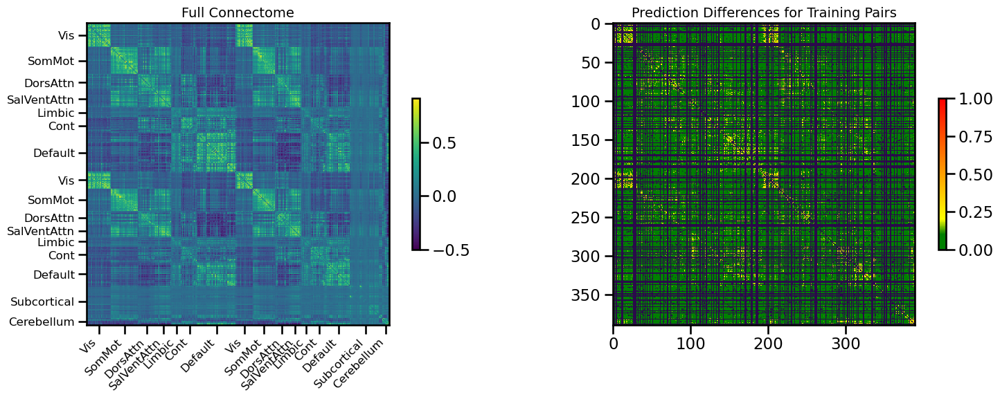

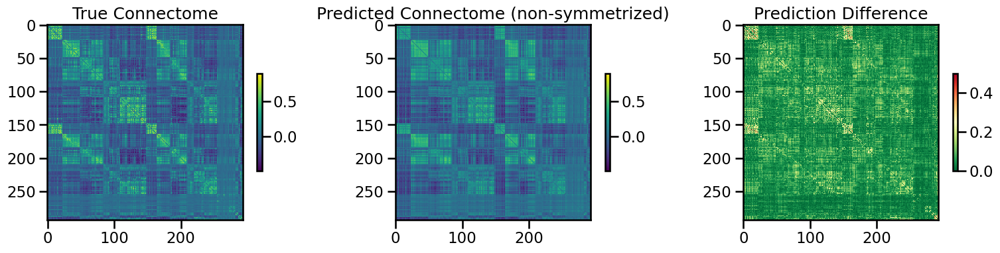

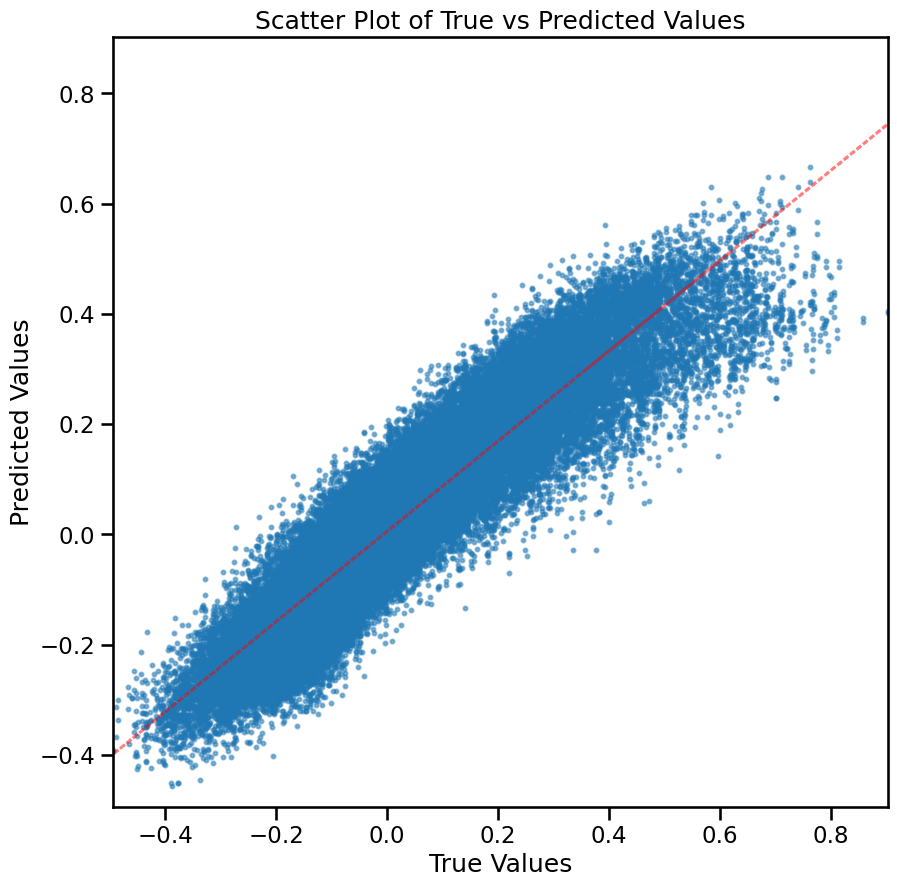

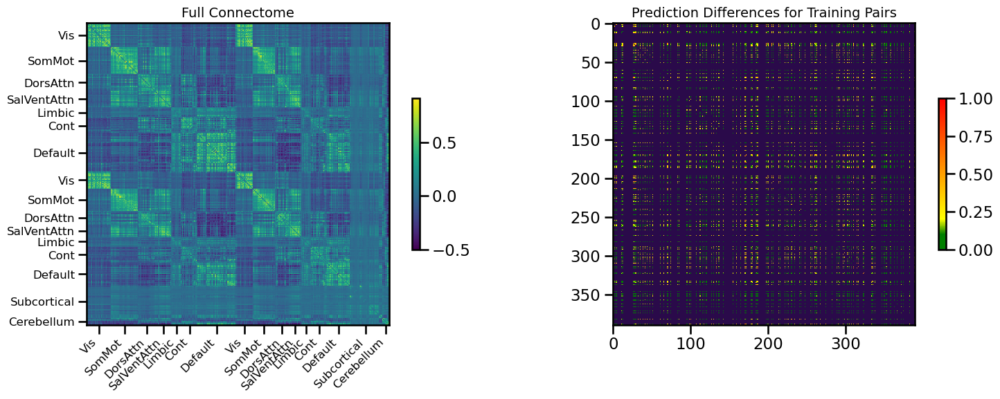

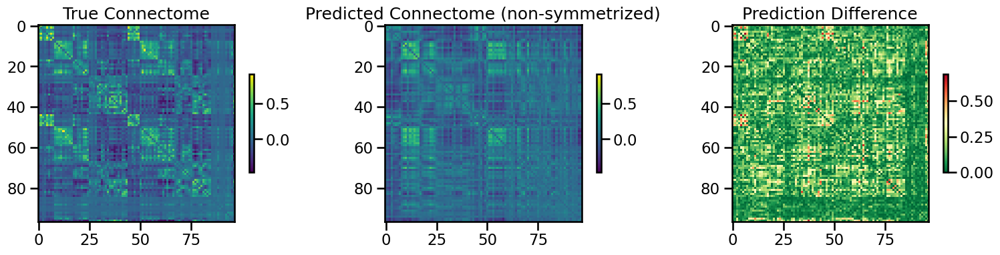

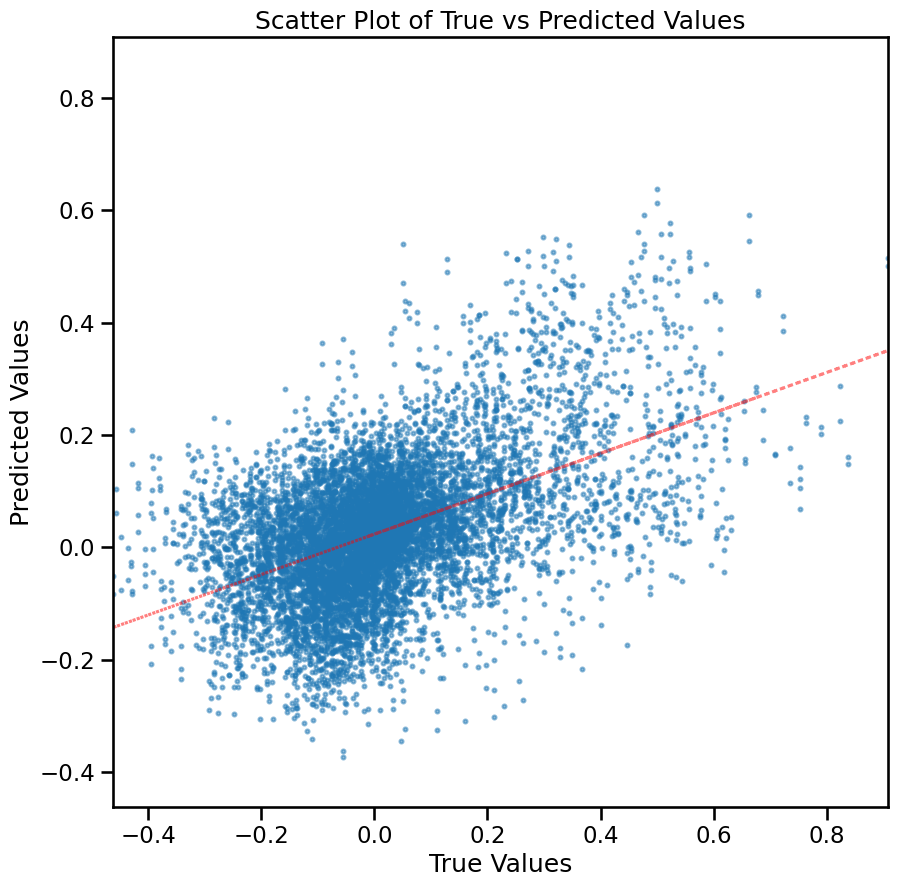


TRAIN METRICS: {'mse': 0.0050945133, 'mae': 0.05275437, 'r2': 0.8448460611959404, 'pearson_corr': 0.9197727342276486, 'geodesic_distance': 18.563743928111958}
TEST METRICS: {'mse': 0.024707299, 'mae': 0.11750208, 'r2': 0.20131193184116003, 'pearson_corr': 0.5026522181557882, 'geodesic_distance': 13.70644841261038}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14760, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100}


  warnings.warn(



1
2
3
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'hidden_dims': [256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}
Number of learnable parameters in MLP: 3812609
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.0356
Best val loss so far at epoch 3: 0.0333
Epoch 5/100, Train Loss: 0.0539, Val Loss: 0.0307
Best val loss so far at epoch 5: 0.0307
Best val loss so far at epoch 6: 0.0297
Epoch 10/100, Train Loss: 0.0219, Val Loss: 0.0288
Best val loss so far at epoch 10: 0.0288
Best val loss so far at epoch 11: 0.0277
Epoch 15/100, Train Loss: 0.0114, Val Loss: 0.0295
Epoch 20/100, Train Loss: 0.0082, Val Loss: 0.0325
Epoch 25/100, Train Loss: 0.0069, Val Loss: 0.0310

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.030323
Epoch 30/100, Train Loss: 0.0054, Val Loss: 0.0293

Early stopping triggered at epoch 31. Restoring best model with Val Loss: 0.0277


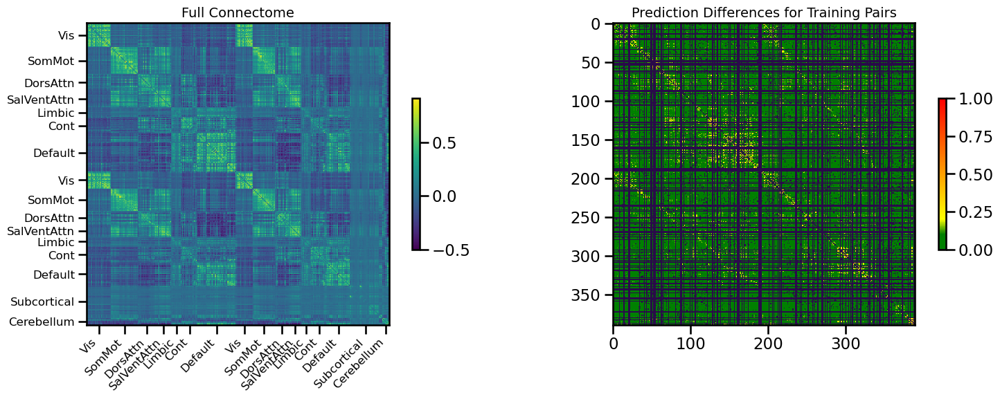

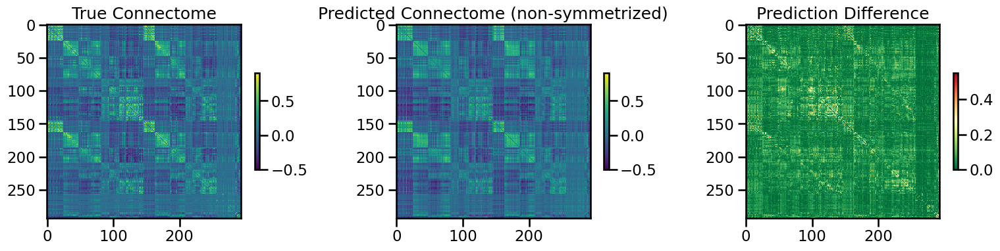

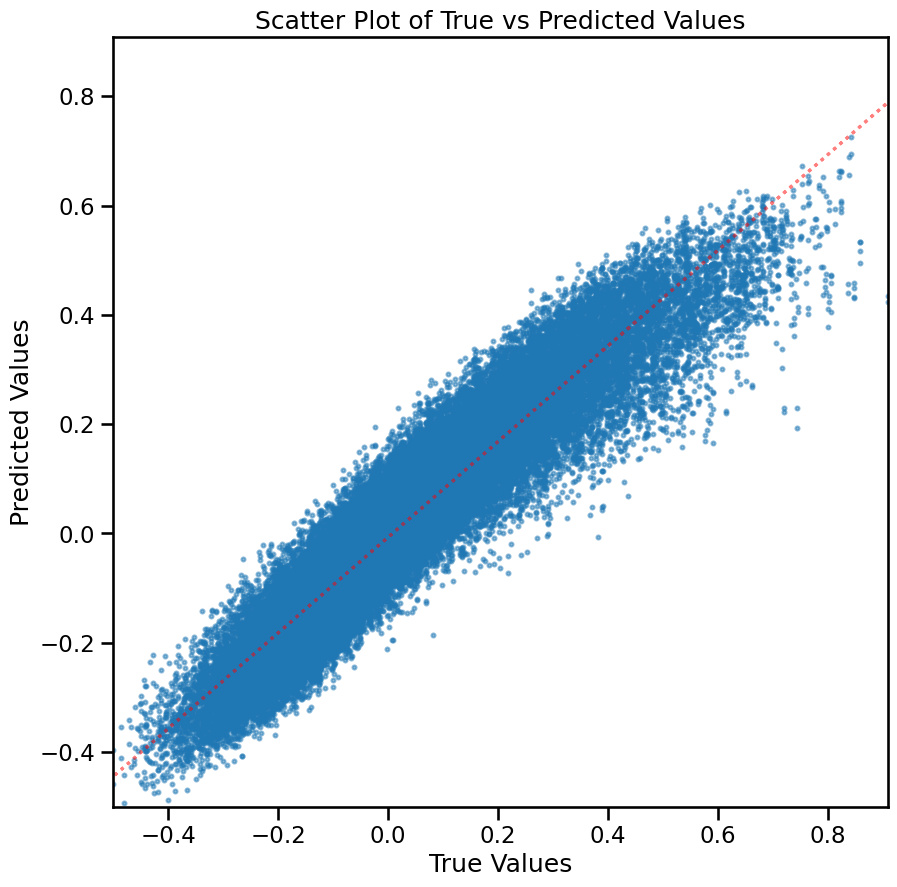

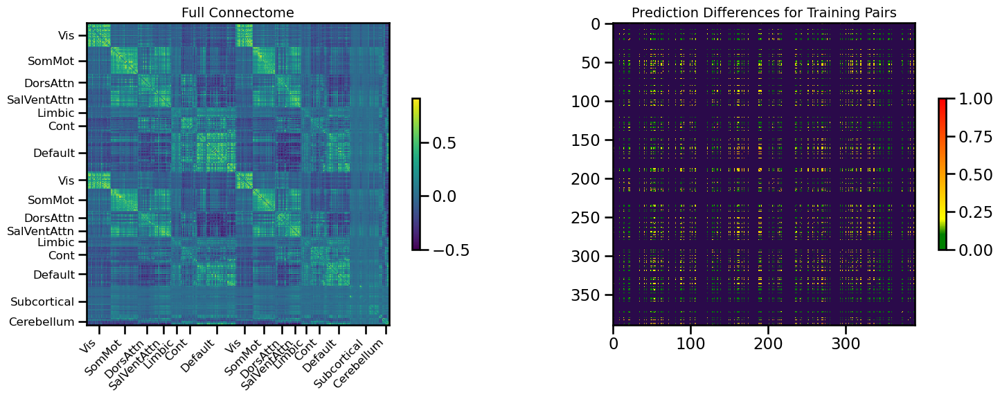

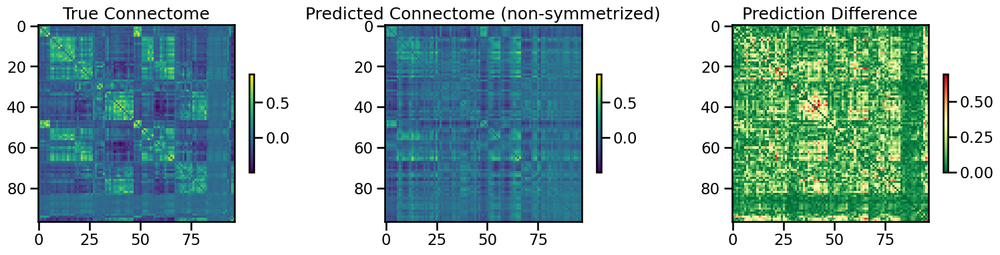

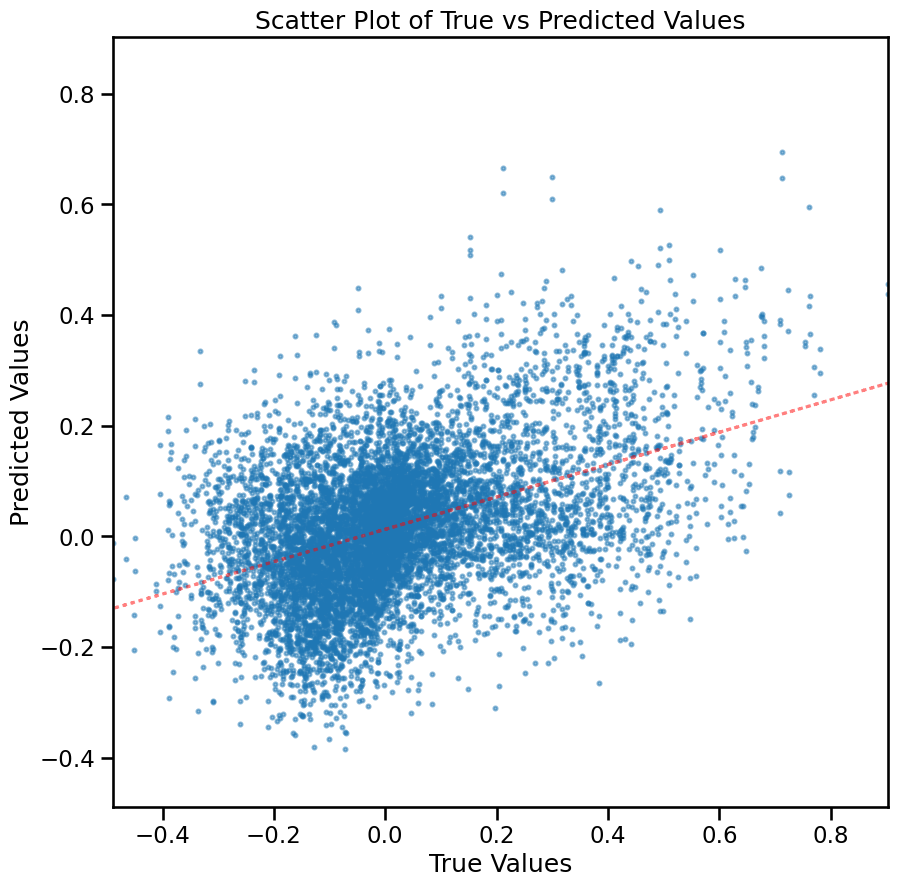


TRAIN METRICS: {'mse': 0.0038880834, 'mae': 0.046127986, 'r2': 0.877193546378594, 'pearson_corr': 0.937894174377494, 'geodesic_distance': 17.450152495353592}
TEST METRICS: {'mse': 0.031127596, 'mae': 0.13207455, 'r2': 0.12389469599715253, 'pearson_corr': 0.4307736490027573, 'geodesic_distance': 16.193497107045886}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14760, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100}
CPU Usage: 17.8%
RAM Usage: 12.2%
Available RAM: 884.1G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |


53803

In [8]:
# Run simulation
single_sim_run(
              cv_type='random',
              random_seed=42,
              model_type='dynamic_mlp',
              feature_type=[{'transcriptome': None}],
              connectome_target='FC',
              binarize=False,
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 3),
              save_sim=False,
              track_wandb=False,
              skip_cv=True
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 105
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (390, 7380)
X_pca shape: (390, 105)
Y_sc shape: (390, 390)
Y_sc_spectralL shape: (390, 455)
Y_sc_spectralA shape: (390, 456)
Y_fc shape: (390, 390)
Coordinates shape: (390, 3)
Y shape (390, 390)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'use_positional_encoding': False, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.2760
Best val loss so far at epoch 2: 0.0297
Best val loss so far at epoch 4: 0.0261
Epoch 5/50, Train Loss: 0.0504, Val Loss: 0.0251
Best val loss so far at epoch 5: 0.0251
Best val loss so far at epoch 6: 0.0233
Best val loss so far at epoch 7: 0.0231
Best val loss so far at epoch 9: 0.0222
Epoch 10/50, Train Loss: 0.0211, Val Loss: 0.0223
Best val loss so far at epoch 11: 0.0221
Epoch 15/50, Train Loss: 0.0113, Val Loss: 0.0225
Best val loss so far at epoch 18: 0.0220
Epoch 20/50, Train Loss: 0.0079, Val Loss: 0.02

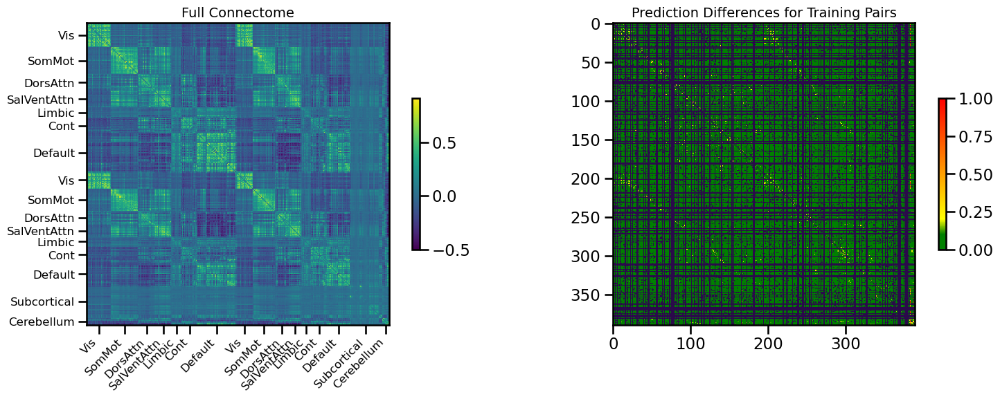

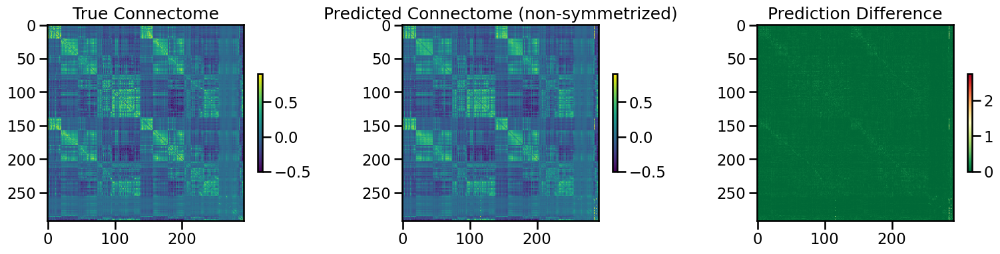

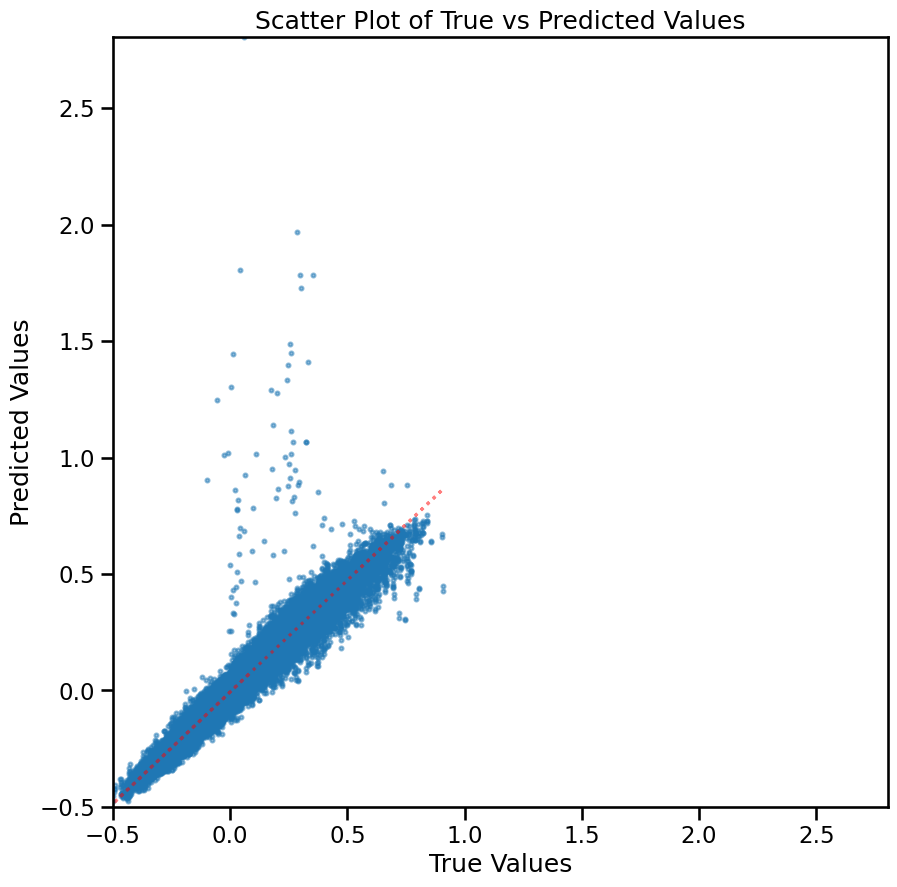

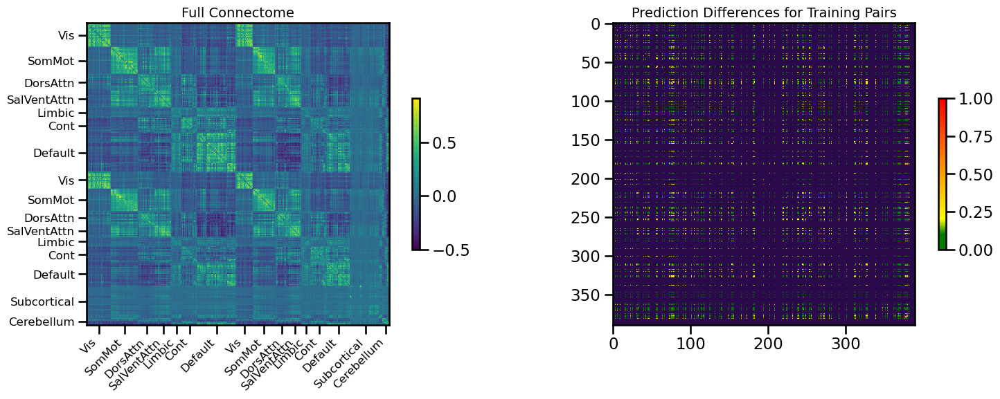

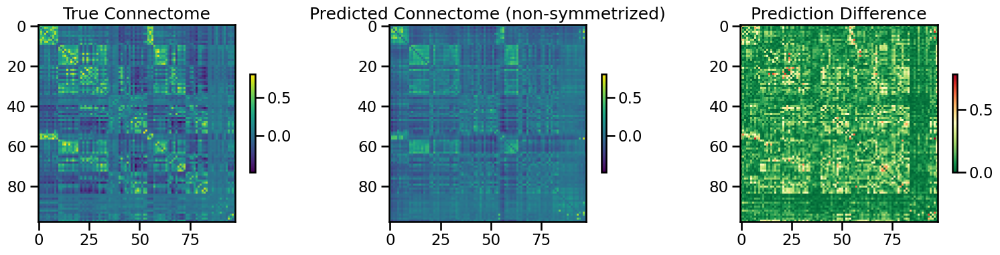

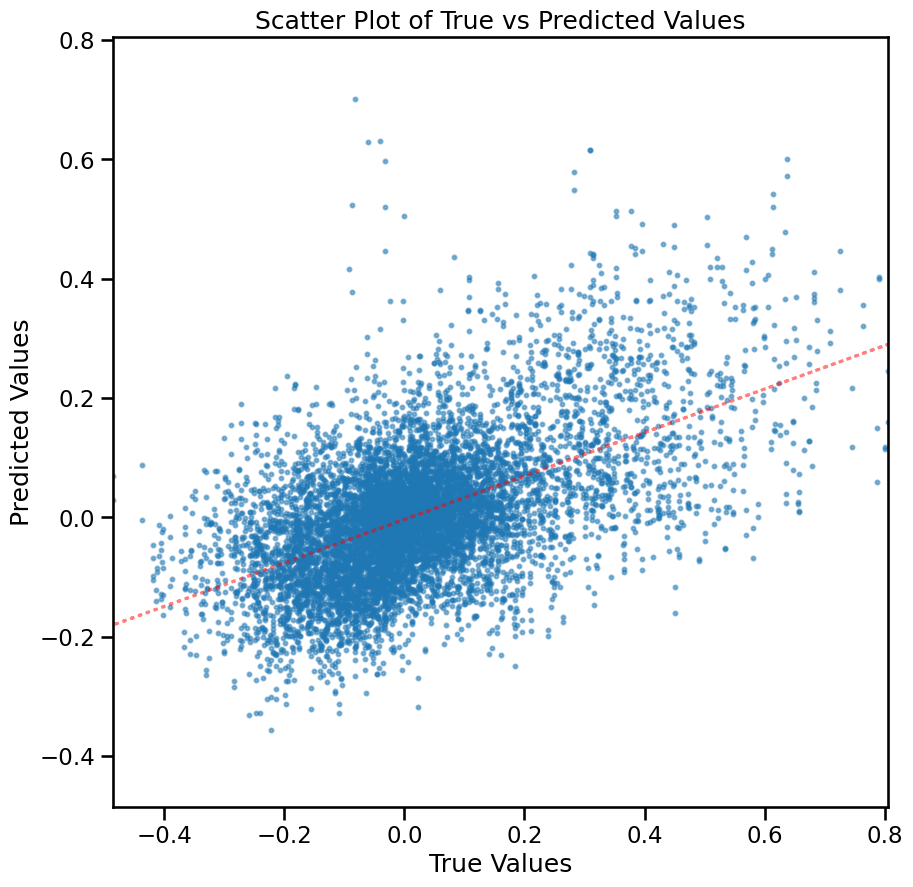


TRAIN METRICS: {'mse': 0.002034758, 'mae': 0.027061194, 'r2': 0.9387377022413218, 'pearson_corr': 0.9698086640862628, 'geodesic_distance': 16.47376446774107}
TEST METRICS: {'mse': 0.02170939, 'mae': 0.10751928, 'r2': 0.2844892440804817, 'pearson_corr': 0.5528039142776903, 'geodesic_distance': 14.89756359643553}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'use_positional_encoding': False, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.0428
Best val loss so far at epoch 2: 0.0304
Best val loss so far at epoch 3: 0.0294
Best val loss so far at epoch 4: 0.0280
Epoch 5/50, Train Loss: 0.0499, Val Loss: 0.0269
Best val loss so far at epoch 5: 0.0269
Best val loss so far at epoch 6: 0.0249
Best val loss so far at epoch 8: 0.0244
Epoch 10/50, Train Loss: 0.0202, Val Loss: 0.0252
Epoch 15/50, Train Loss: 0.0105, Val Loss: 0.0266
Epoch 20/50, Train Loss: 0.0074, Val Loss: 0.0272
Epoch 25/50, Train Loss: 0.0060, Val Loss: 0.0270

LR REDUCED: 0.000090 → 0.000

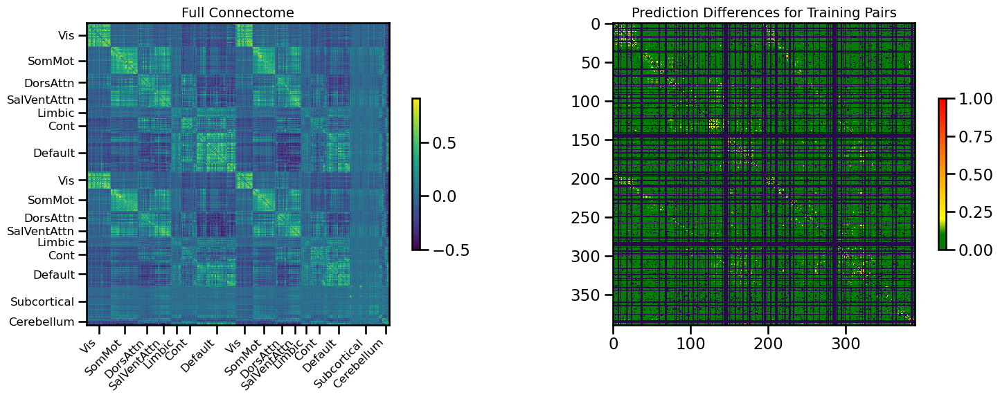

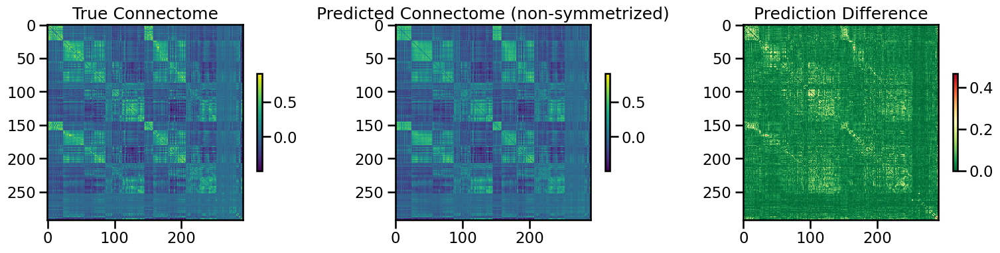

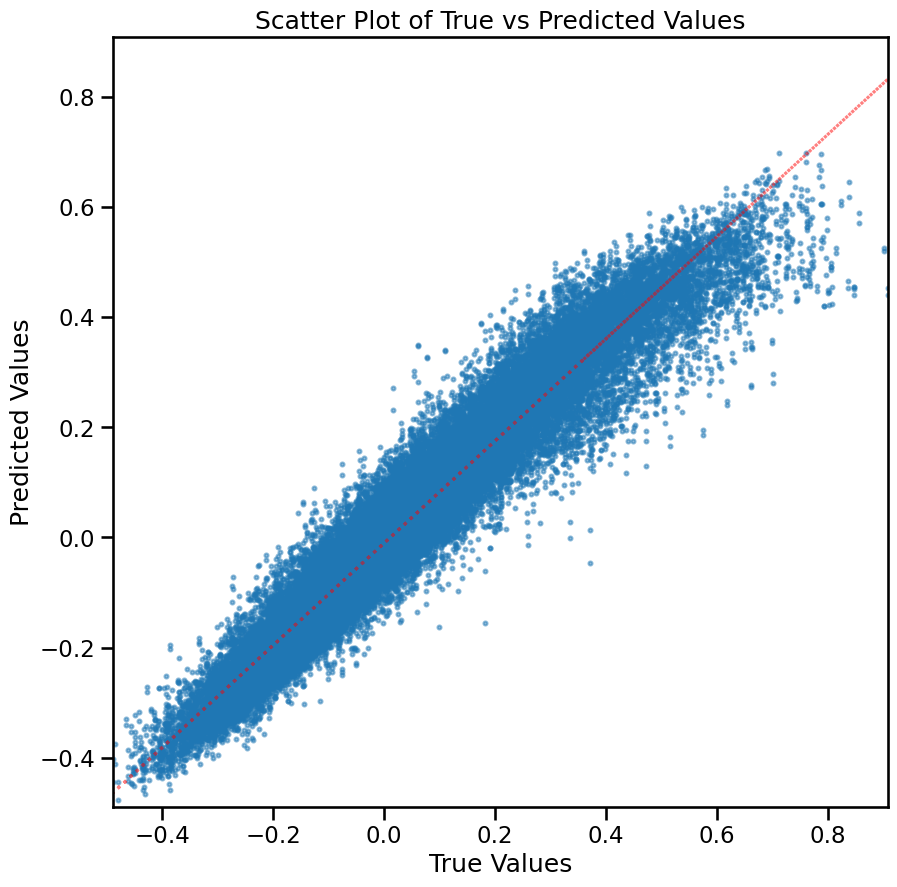

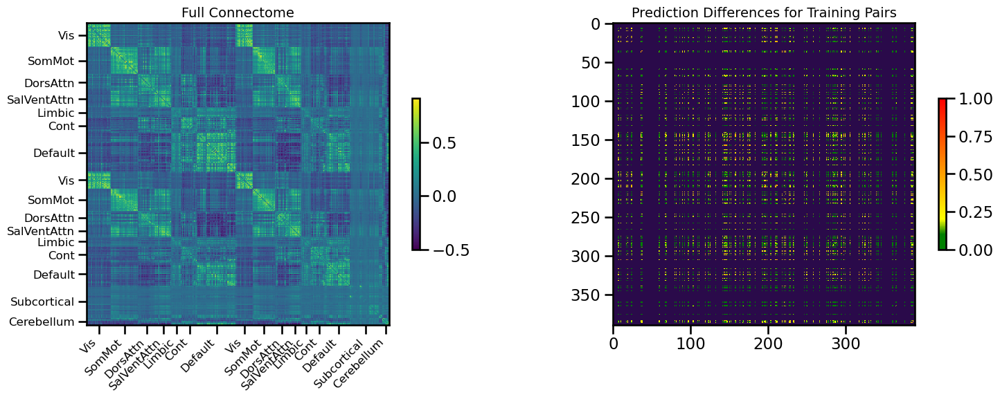

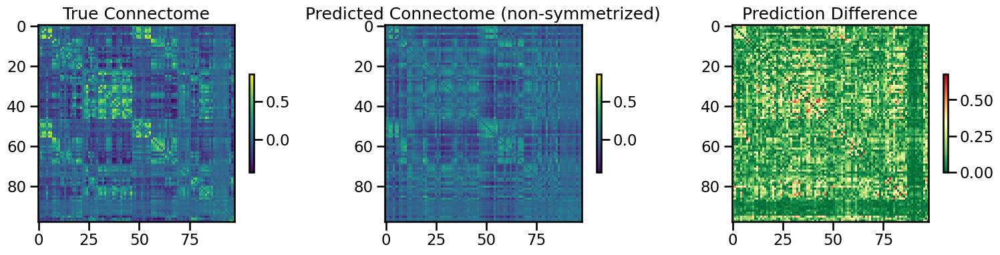

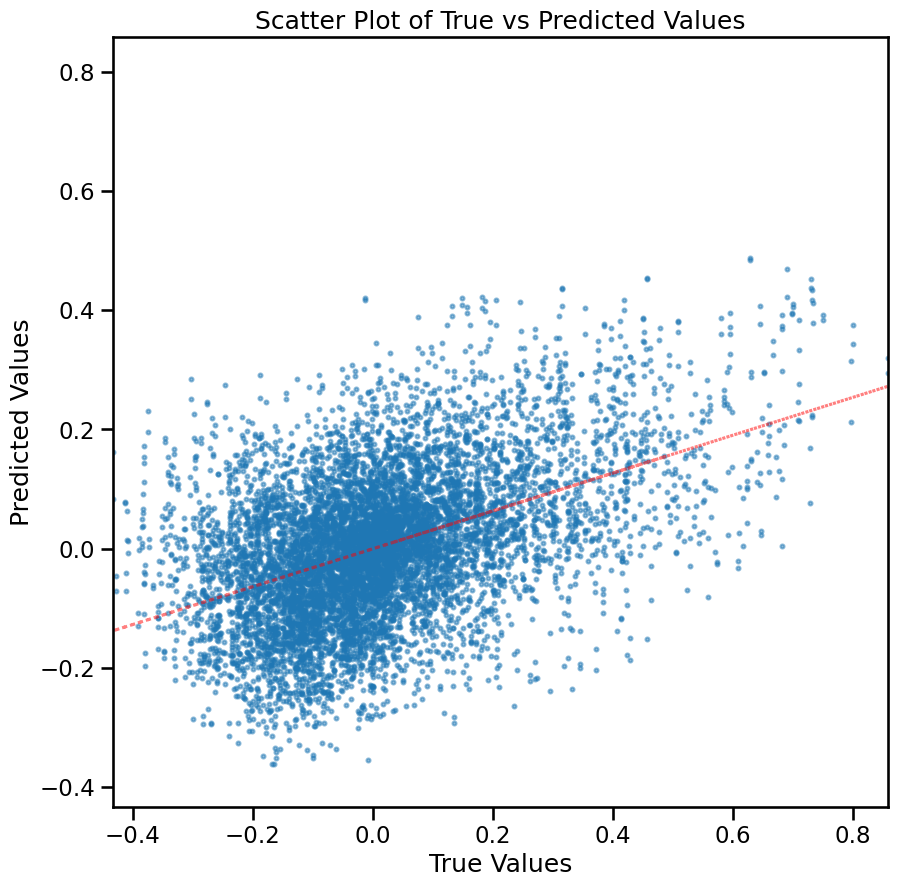


TRAIN METRICS: {'mse': 0.002315835, 'mae': 0.03418442, 'r2': 0.9296958839581762, 'pearson_corr': 0.966330522336153, 'geodesic_distance': 17.413339151265017}
TEST METRICS: {'mse': 0.026506543, 'mae': 0.12173892, 'r2': 0.1650470181186755, 'pearson_corr': 0.46402905140864525, 'geodesic_distance': 16.510633074593425}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}


  warnings.warn(



1
2
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'use_positional_encoding': False, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.0373
Best val loss so far at epoch 2: 0.0294
Best val loss so far at epoch 4: 0.0264
Epoch 5/50, Train Loss: 0.0528, Val Loss: 0.0259
Best val loss so far at epoch 5: 0.0259
Best val loss so far at epoch 7: 0.0226
Best val loss so far at epoch 8: 0.0215
Epoch 10/50, Train Loss: 0.0218, Val Loss: 0.0214
Best val loss so far at epoch 10: 0.0214
Epoch 15/50, Train Loss: 0.0116, Val Loss: 0.0214
Best val loss so far at epoch 15: 0.0214
Best val loss so far at epoch 17: 0.0212
Best val loss so far at epoch 19: 0.0211
Epoch

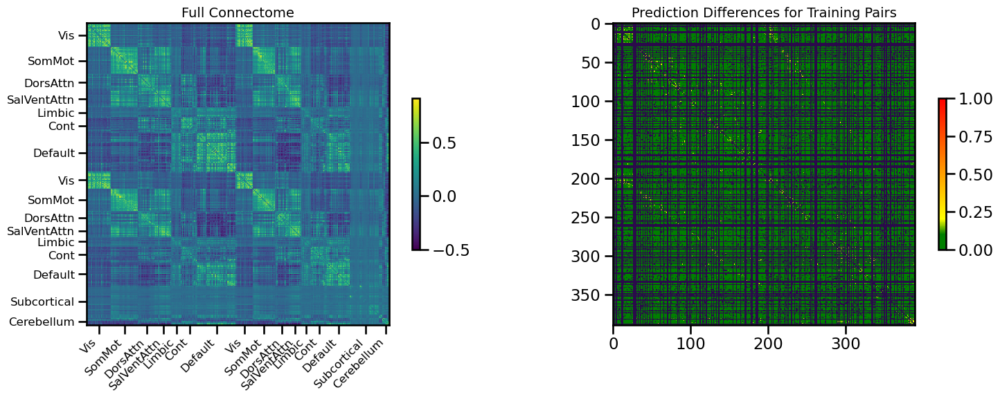

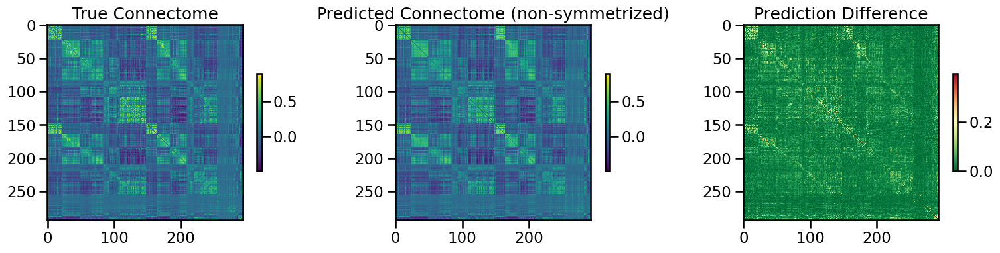

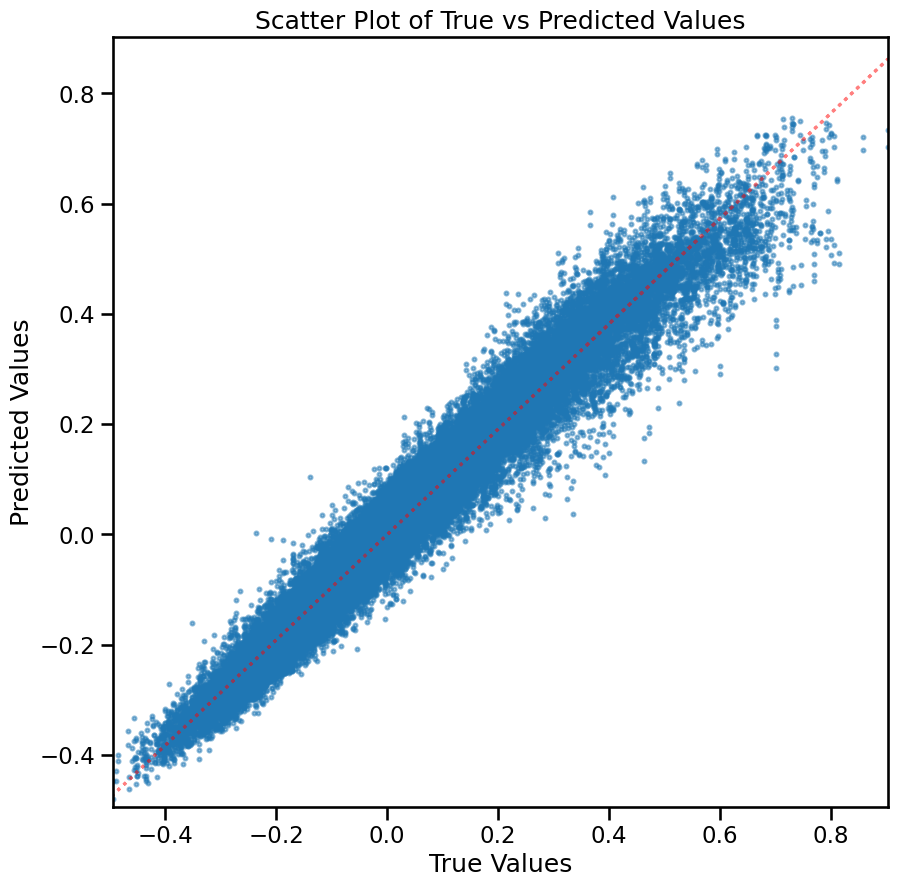

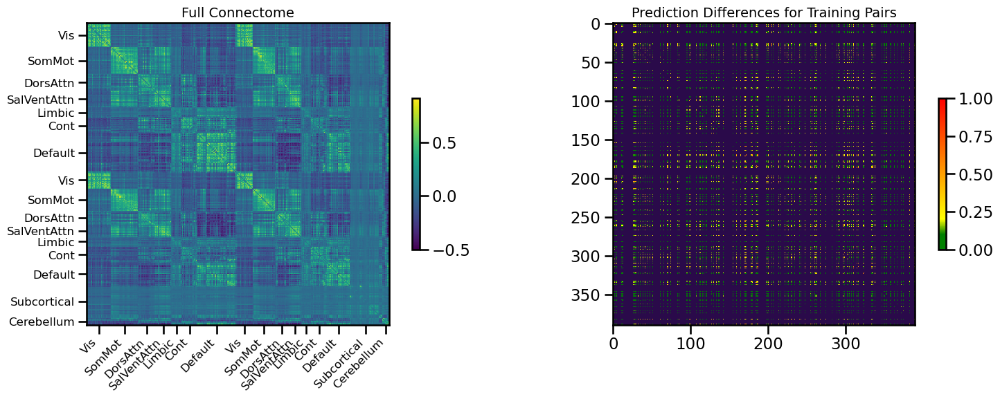

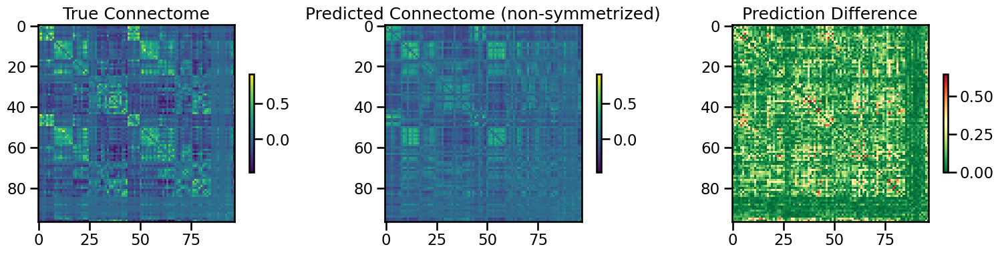

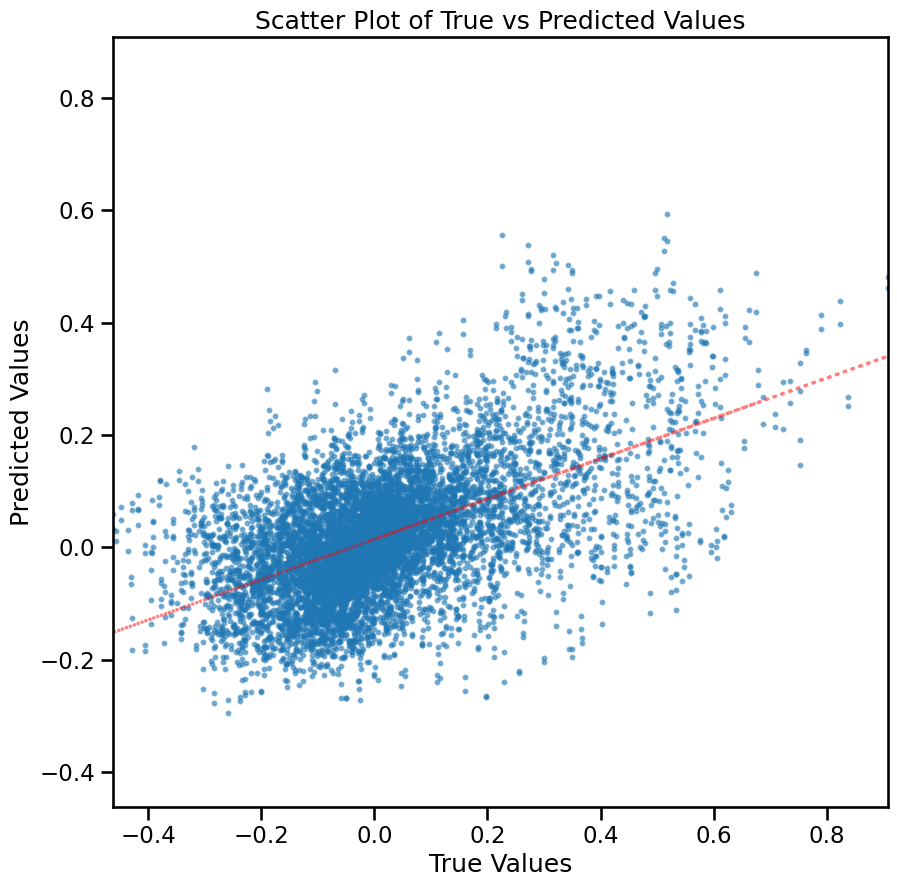


TRAIN METRICS: {'mse': 0.0014266014, 'mae': 0.026886418, 'r2': 0.9565527027083854, 'pearson_corr': 0.9780473964988491, 'geodesic_distance': 15.652102233242971}
TEST METRICS: {'mse': 0.0215831, 'mae': 0.106003165, 'r2': 0.30230468095330276, 'pearson_corr': 0.5571940636936322, 'geodesic_distance': 13.796576211604338}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}


  warnings.warn(



1
2
3
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'use_positional_encoding': False, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.0369
Best val loss so far at epoch 2: 0.0334
Best val loss so far at epoch 3: 0.0318
Best val loss so far at epoch 4: 0.0304
Epoch 5/50, Train Loss: 0.0494, Val Loss: 0.0297
Best val loss so far at epoch 5: 0.0297
Best val loss so far at epoch 6: 0.0288
Best val loss so far at epoch 7: 0.0283
Best val loss so far at epoch 9: 0.0273
Epoch 10/50, Train Loss: 0.0203, Val Loss: 0.0273
Best val loss so far at epoch 10: 0.0273
Best val loss so far at epoch 11: 0.0272
Best val loss so far at epoch 14: 0.0271
Epoch 15/50, Tra

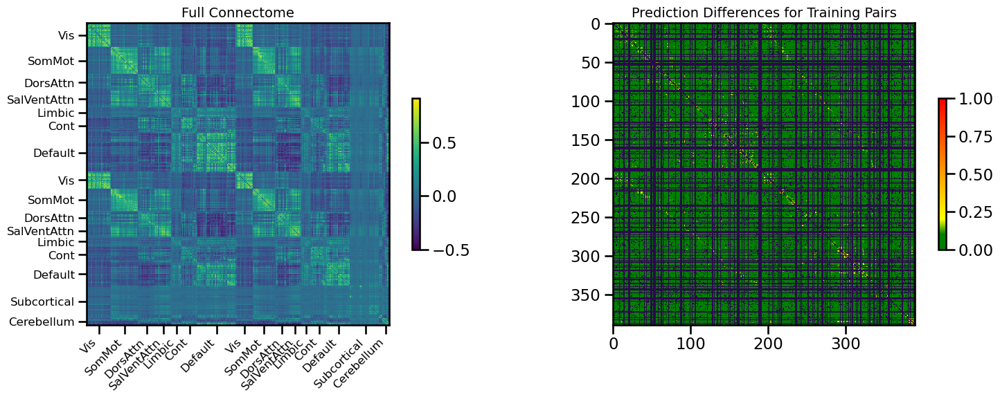

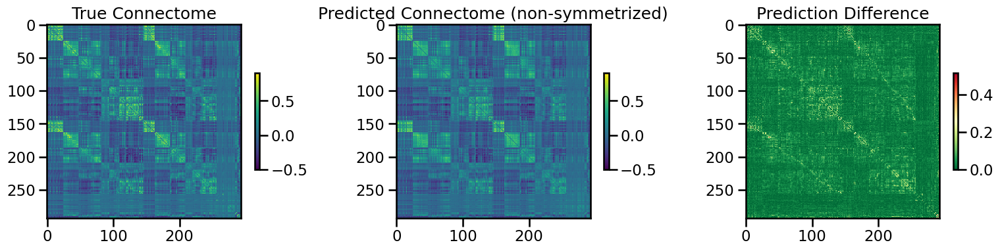

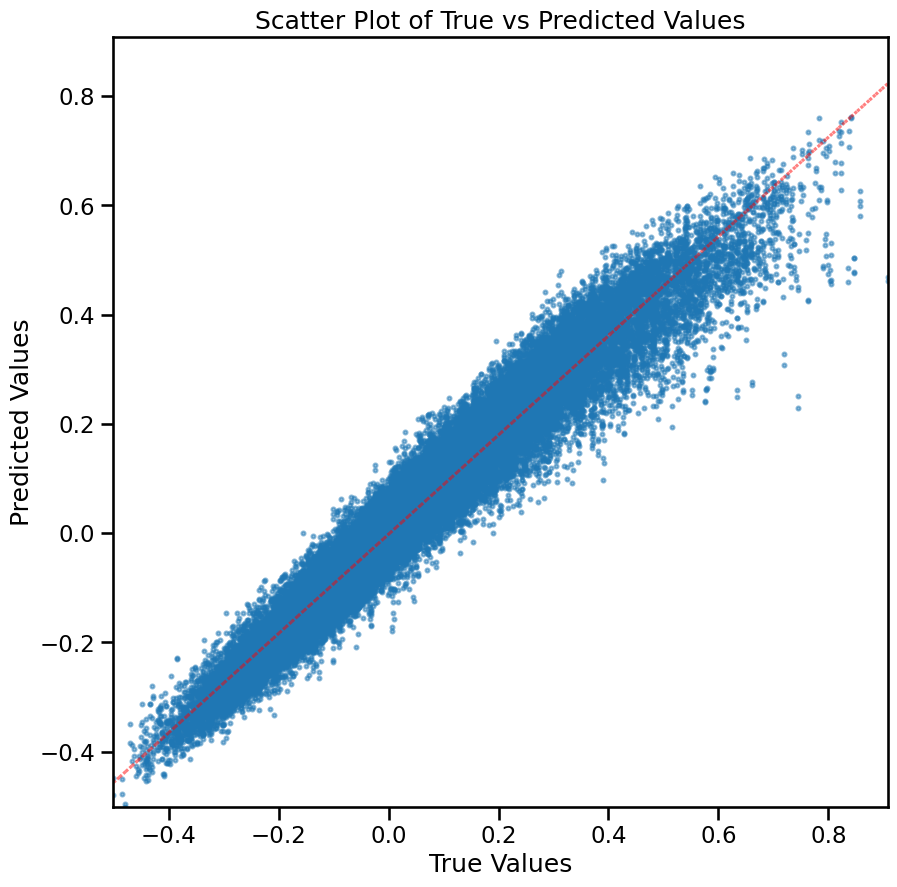

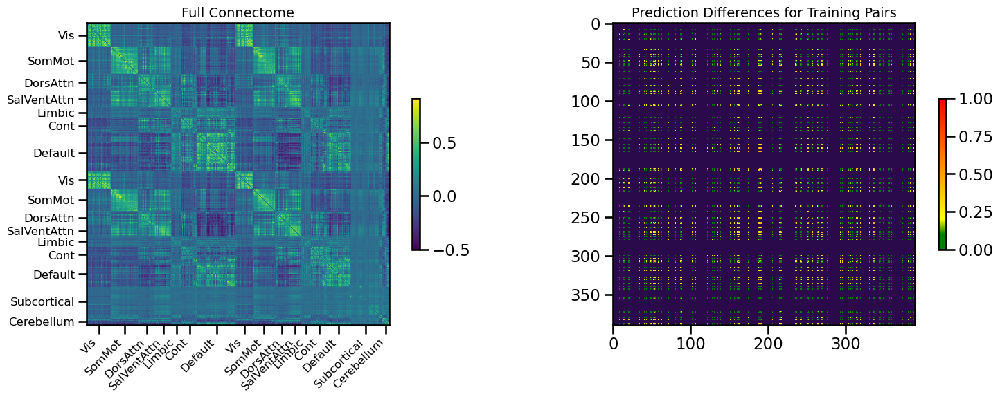

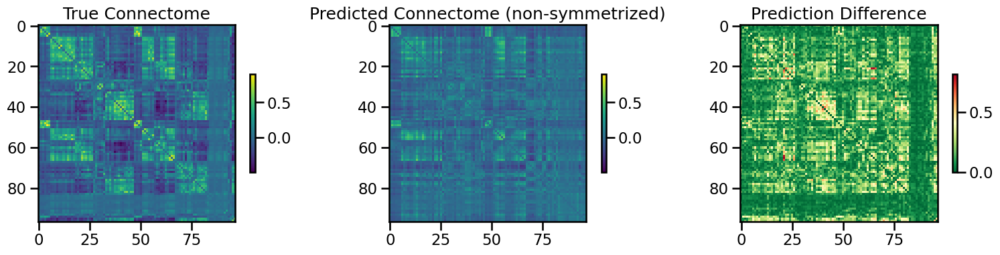

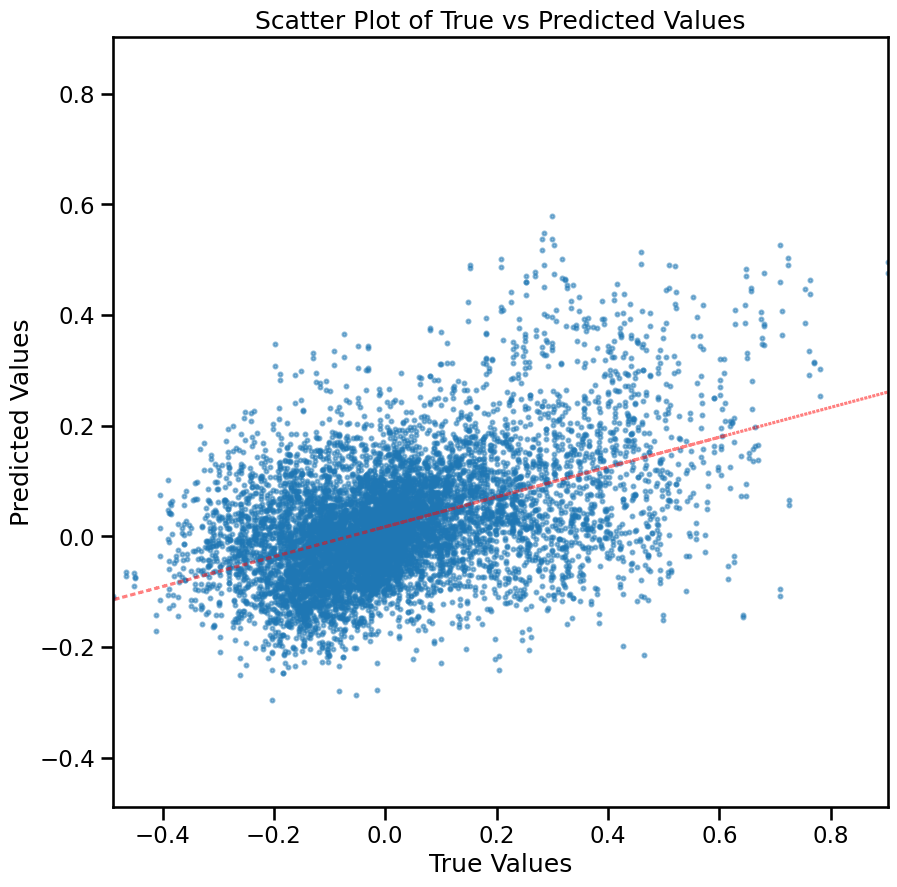


TRAIN METRICS: {'mse': 0.0017400568, 'mae': 0.029442556, 'r2': 0.9450397080372689, 'pearson_corr': 0.9731467983732518, 'geodesic_distance': 15.466452182506911}
TEST METRICS: {'mse': 0.027950402, 'mae': 0.12198066, 'r2': 0.21331873680927127, 'pearson_corr': 0.47277376721548975, 'geodesic_distance': 15.170394063226794}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}
CPU Usage: 19.0%
RAM Usage: 12.9%
Available RAM: 877.1G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 10% |


56879

In [9]:
# Run simulation
single_sim_run(
              cv_type='random',
              random_seed=42,
              model_type='shared_transformer',
              feature_type=[{'transcriptome': None}],
              connectome_target='FC',
              binarize=False,\
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 3),
              save_sim=False,
              track_wandb=False,
              skip_cv=True
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 105
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (390, 7380)
X_pca shape: (390, 105)
Y_sc shape: (390, 390)
Y_sc_spectralL shape: (390, 455)
Y_sc_spectralA shape: (390, 456)
Y_fc shape: (390, 390)
Coordinates shape: (390, 3)
Y shape (390, 390)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin


2
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'use_positional_encoding': False, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}


  warnings.warn(



Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.01 GB
Best val loss so far at epoch 1: 0.0353
Best val loss so far at epoch 2: 0.0319
Best val loss so far at epoch 3: 0.0290
Best val loss so far at epoch 4: 0.0270
Epoch 5/50, Train Loss: 0.0514, Val Loss: 0.0272
Best val loss so far at epoch 6: 0.0263
Best val loss so far at epoch 7: 0.0260
Best val loss so far at epoch 9: 0.0253
Epoch 10/50, Train Loss: 0.0275, Val Loss: 0.0237
Best val loss so far at epoch 10: 0.0237
Best val loss so far at epoch 11: 0.0230
Best val loss so far at epoch 12: 0.0223
Best val loss so far at epoch 13: 0.0223
Best val loss so far at epoch 14: 0.0207
Epoch 15/50, Train Loss: 0.0167, Val Loss: 0.0207
Best val loss so far at epoch 18: 0.0199
Epoch 20/50, Train Loss: 0.0108, Val Loss: 0.0219
Best val loss so far at epoch 22: 0.0191
Best val loss so far at epoch 23: 0.0188
Epoch 25/50, Train Loss: 0.0075, Val Loss: 0.0189
Best val loss so far at epoch 28: 0.0182
Epoch 30/50, Train Loss: 0.

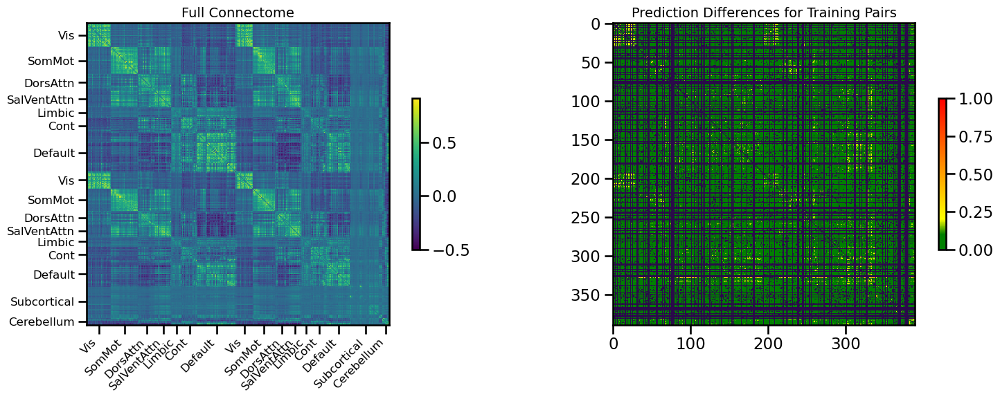

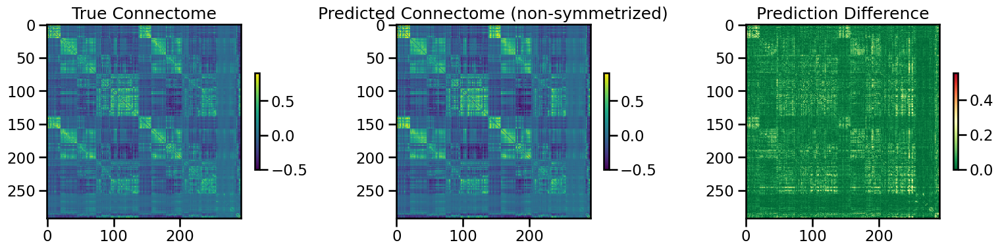

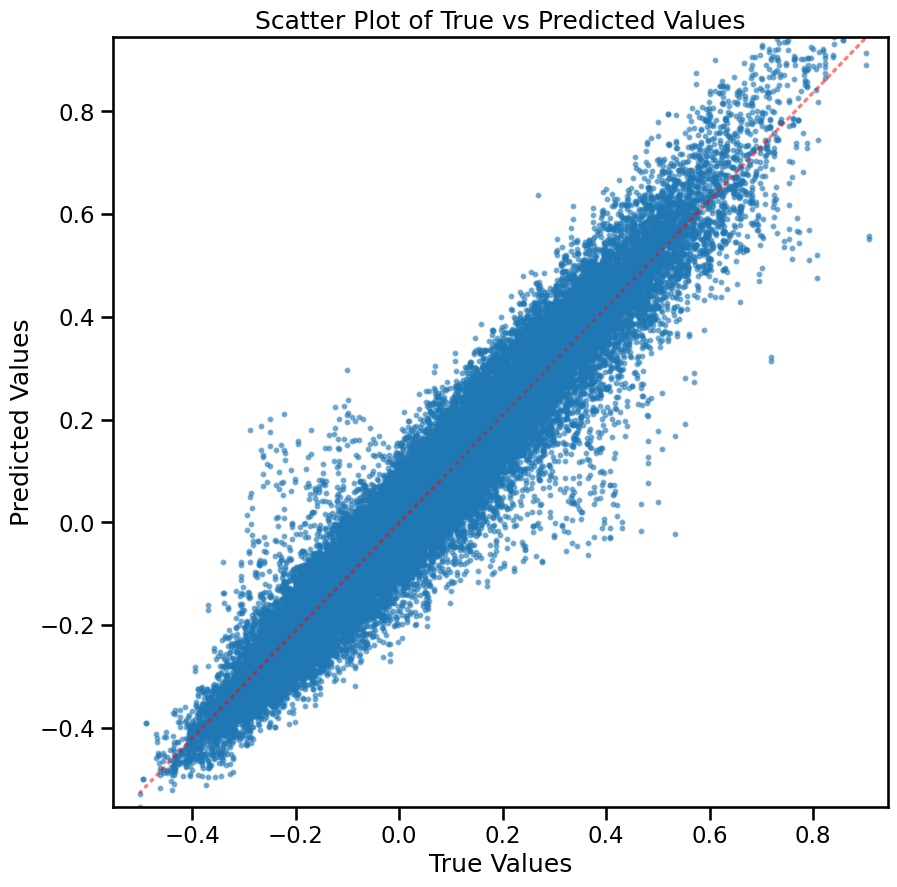

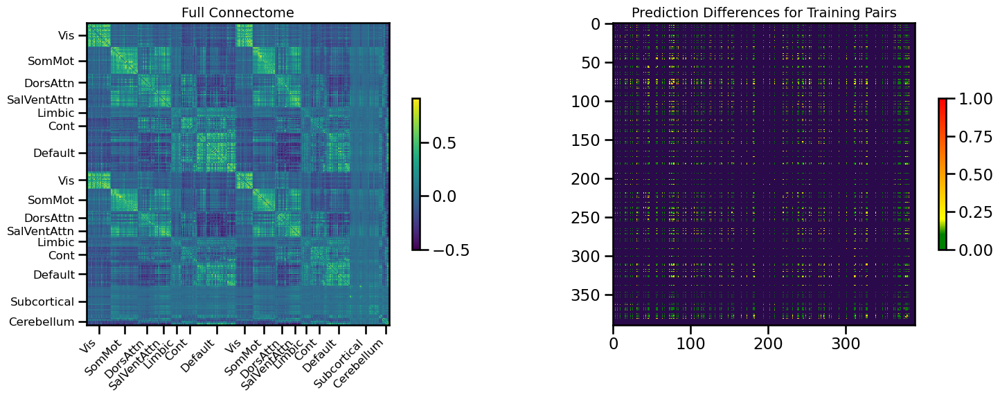

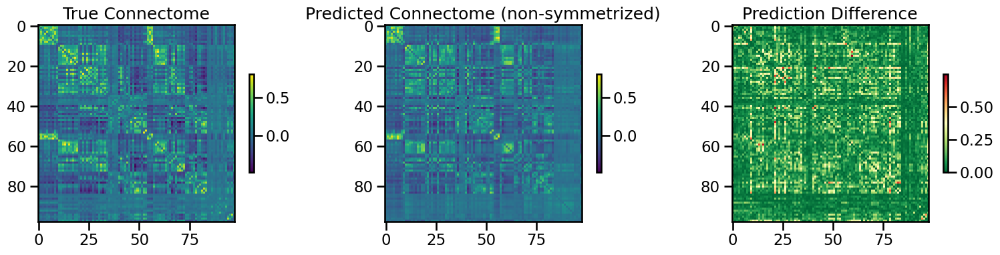

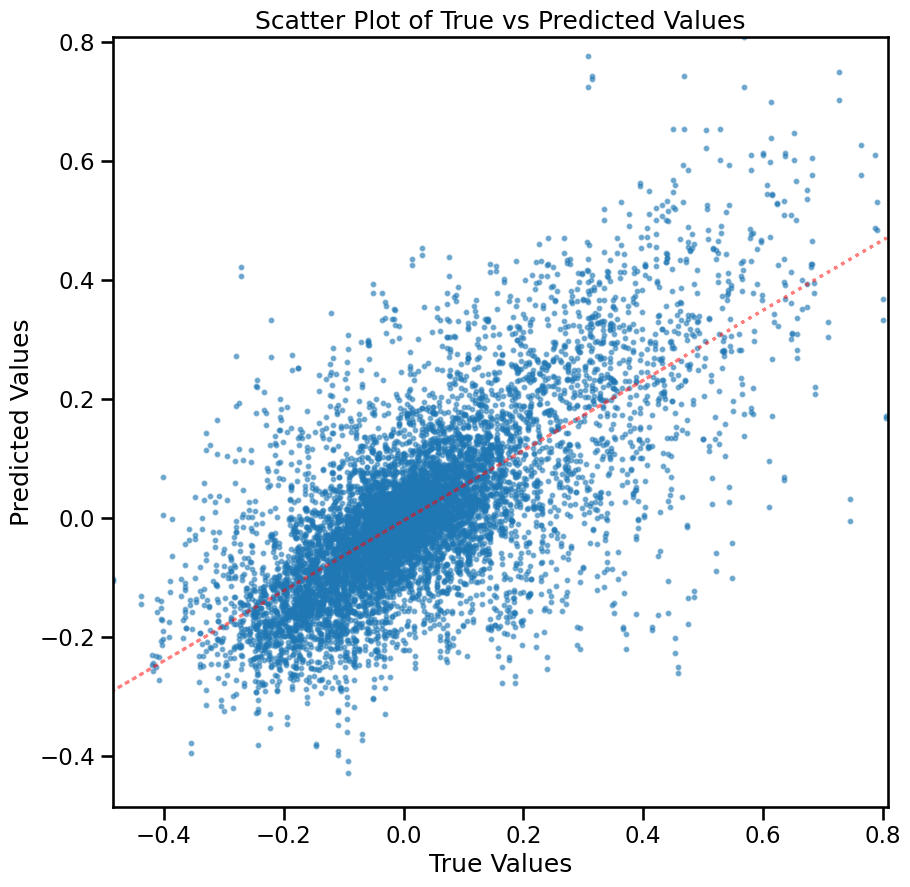


TRAIN METRICS: {'mse': 0.0028446717, 'mae': 0.037476953, 'r2': 0.9143529036150799, 'pearson_corr': 0.9639477039035512, 'geodesic_distance': 15.183920038761753}
TEST METRICS: {'mse': 0.016483234, 'mae': 0.08852926, 'r2': 0.45673594490928815, 'pearson_corr': 0.696245106018574, 'geodesic_distance': 11.70120690955482}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'use_positional_encoding': False, 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'use_positional_encoding': False, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.05 GB
Best val loss so far at epoch 1: 0.0448
Best val loss so far at epoch 2: 0.0343
Best val loss so far at epoch 4: 0.0302
Epoch 5/50, Train Loss: 0.0628, Val Loss: 0.0323
Epoch 10/50, Train Loss: 0.0357, Val Loss: 0.0301
Best val loss so far at epoch 10: 0.0301
Best val loss so far at epoch 11: 0.0291
Best val loss so far at epoch 12: 0.0276
Best val loss so far at epoch 13: 0.0265
Epoch 15/50, Train Loss: 0.0210, Val Loss: 0.0257
Best val loss so far at epoch 15: 0.0257
Best val loss so far at epoch 16: 0.0247
Epoch 20/50, Train Loss: 0.0135, Val Loss: 

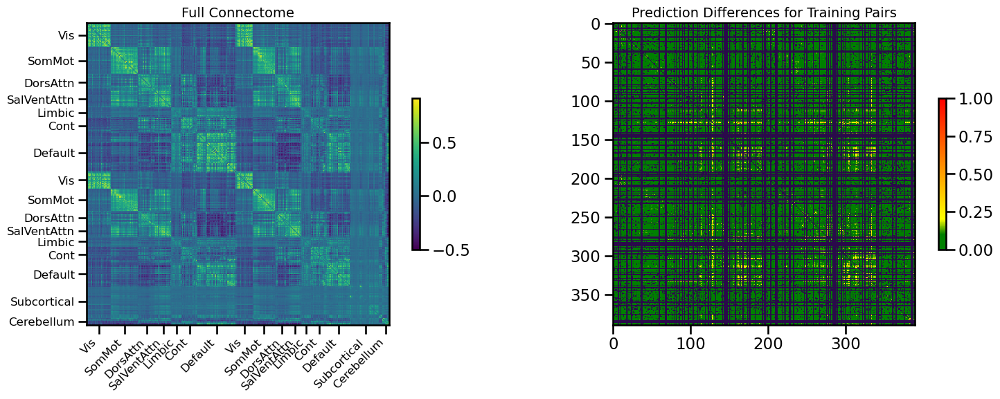

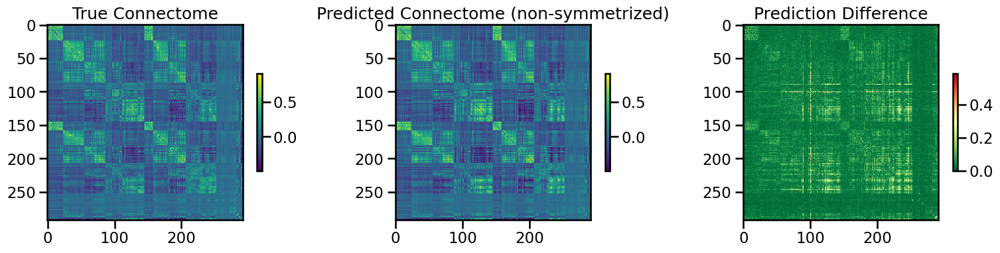

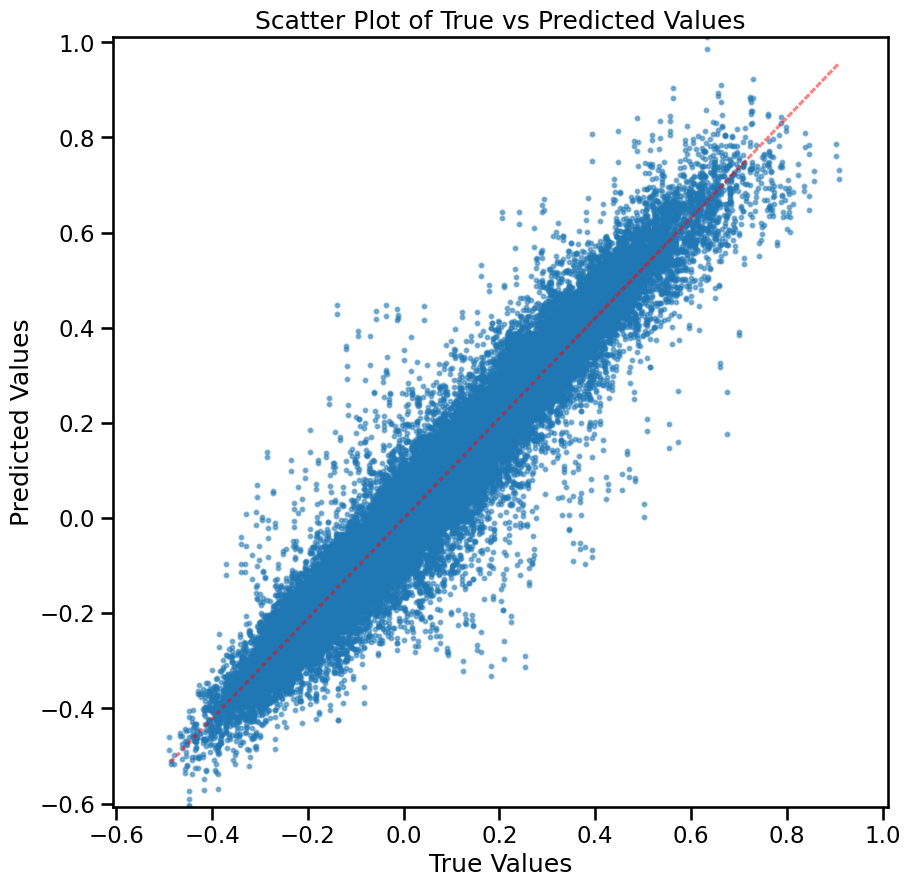

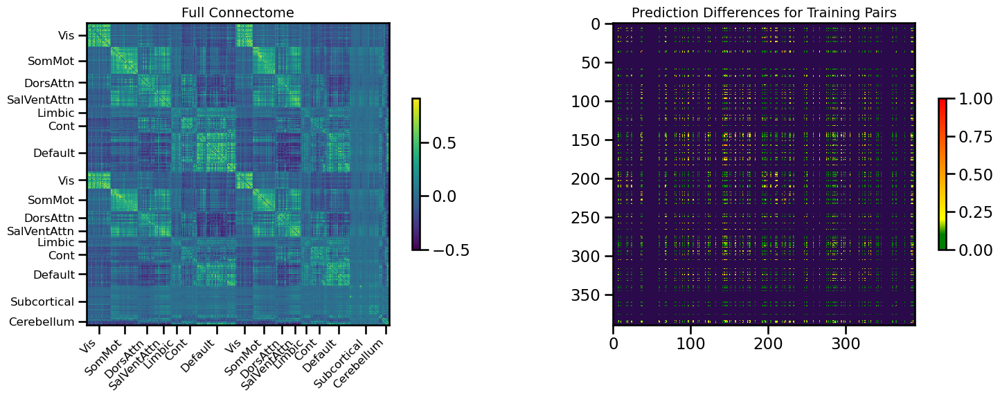

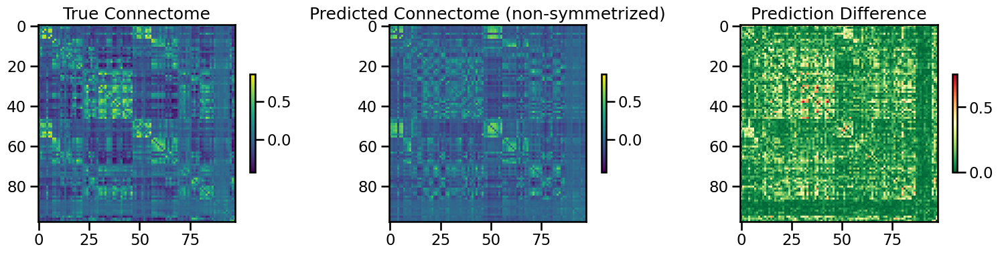

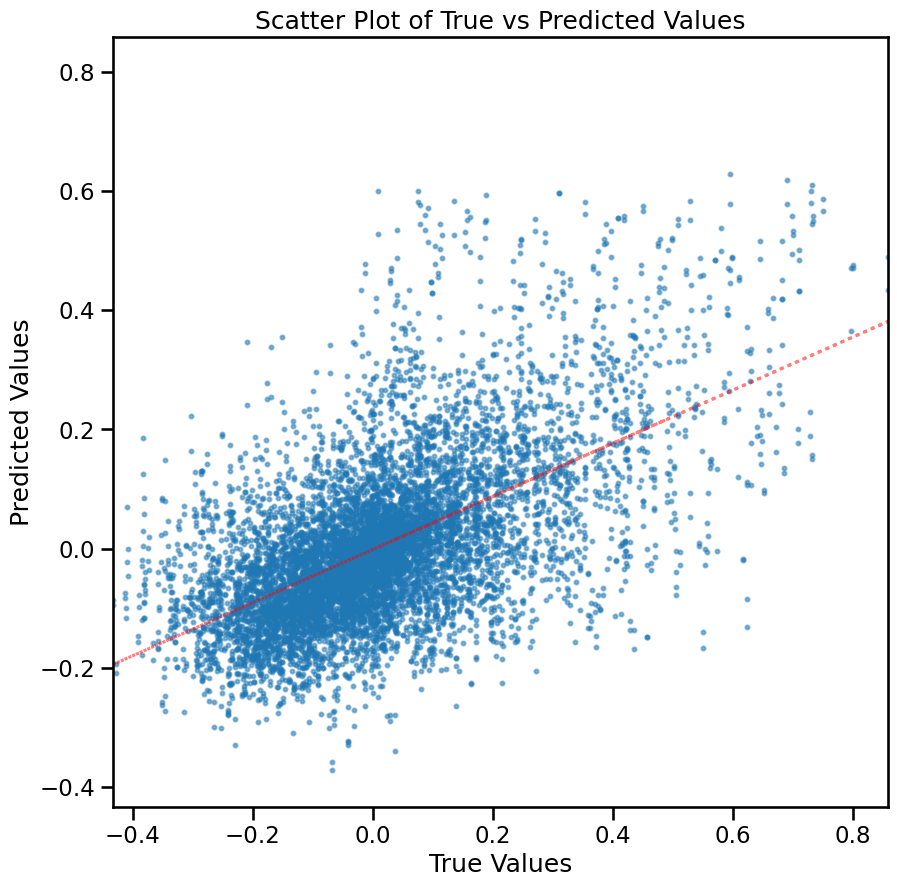


TRAIN METRICS: {'mse': 0.0028359303, 'mae': 0.035294008, 'r2': 0.9139068394196874, 'pearson_corr': 0.9643582028176098, 'geodesic_distance': 14.200661935471938}
TEST METRICS: {'mse': 0.021652447, 'mae': 0.106481366, 'r2': 0.31795049463123226, 'pearson_corr': 0.589342461826587, 'geodesic_distance': 13.017660704360956}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'use_positional_encoding': False, 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}


  warnings.warn(



1
2
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'use_positional_encoding': False, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.05 GB
Best val loss so far at epoch 1: 0.0299
Best val loss so far at epoch 2: 0.0268
Best val loss so far at epoch 4: 0.0265
Epoch 5/50, Train Loss: 0.0567, Val Loss: 0.0257
Best val loss so far at epoch 5: 0.0257
Epoch 10/50, Train Loss: 0.0273, Val Loss: 0.0324
Epoch 15/50, Train Loss: 0.0198, Val Loss: 0.0279
Epoch 20/50, Train Loss: 0.0161, Val Loss: 0.0265

Early stopping triggered at epoch 20. Restoring best model with Val Loss: 0.0257


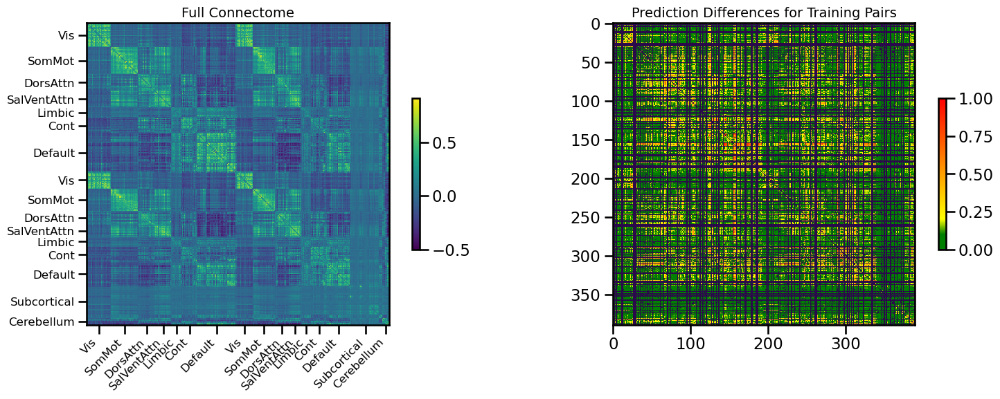

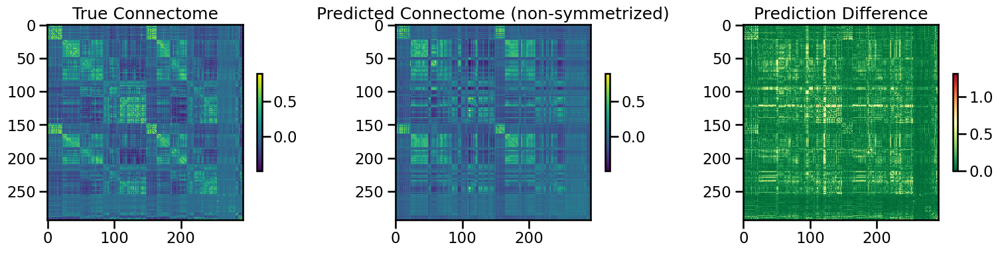

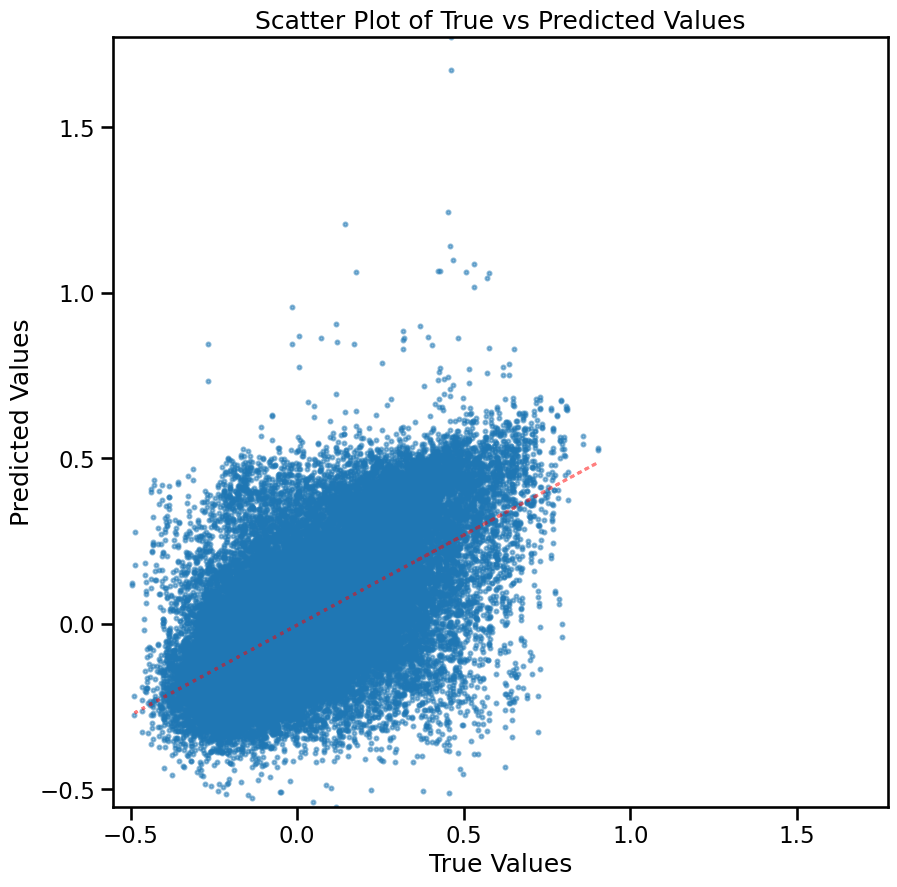

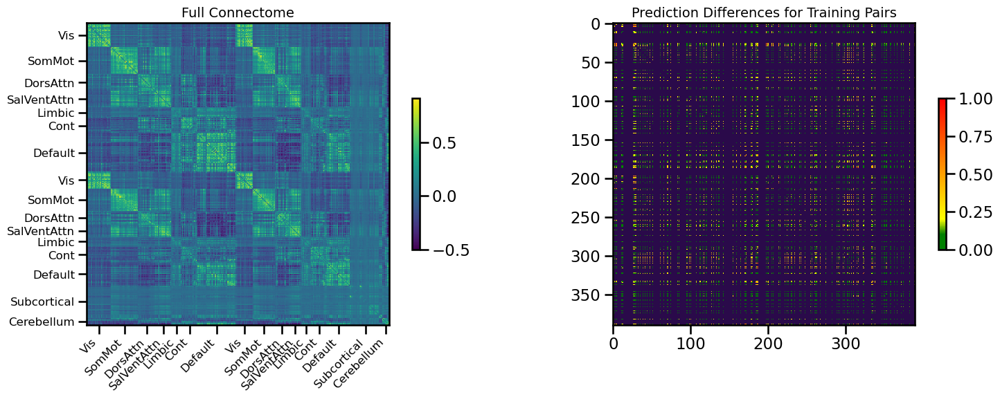

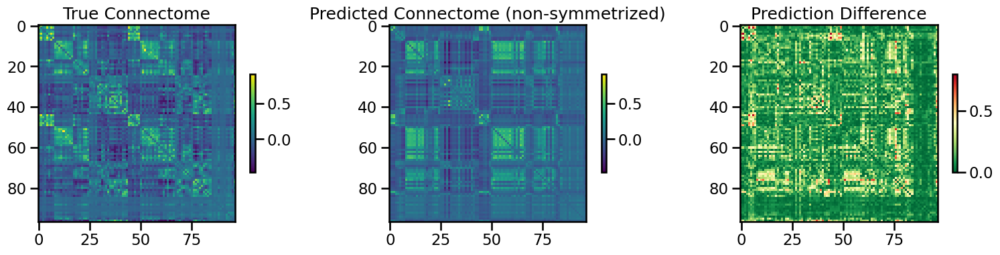

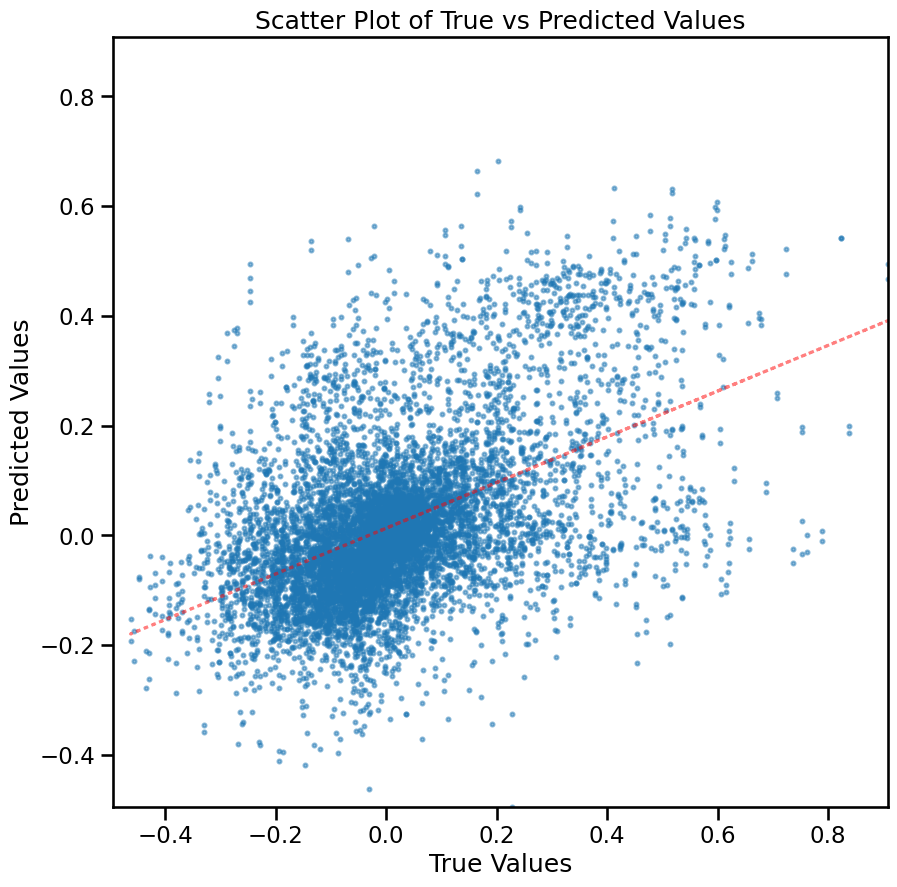


TRAIN METRICS: {'mse': 0.024358878, 'mae': 0.10760386, 'r2': 0.2581478184165136, 'pearson_corr': 0.598435882652081, 'geodesic_distance': 22.57787855327132}
TEST METRICS: {'mse': 0.0274846, 'mae': 0.11654675, 'r2': 0.11153286902748616, 'pearson_corr': 0.4905094975976401, 'geodesic_distance': 13.274350285436986}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'use_positional_encoding': False, 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}


  warnings.warn(



1
2
3
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'use_positional_encoding': False, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.05 GB
Best val loss so far at epoch 1: 0.0326
Best val loss so far at epoch 2: 0.0310
Best val loss so far at epoch 4: 0.0287
Epoch 5/50, Train Loss: 0.0489, Val Loss: 0.0278
Best val loss so far at epoch 5: 0.0278
Best val loss so far at epoch 6: 0.0268
Best val loss so far at epoch 7: 0.0260
Best val loss so far at epoch 8: 0.0255
Best val loss so far at epoch 9: 0.0254
Epoch 10/50, Train Loss: 0.0249, Val Loss: 0.0243
Best val loss so far at epoch 10: 0.0243
Best val loss so far at epoch 11: 0.0237
Best val loss so far at epoch 13: 0.0223
Epoch 15/50, Tra

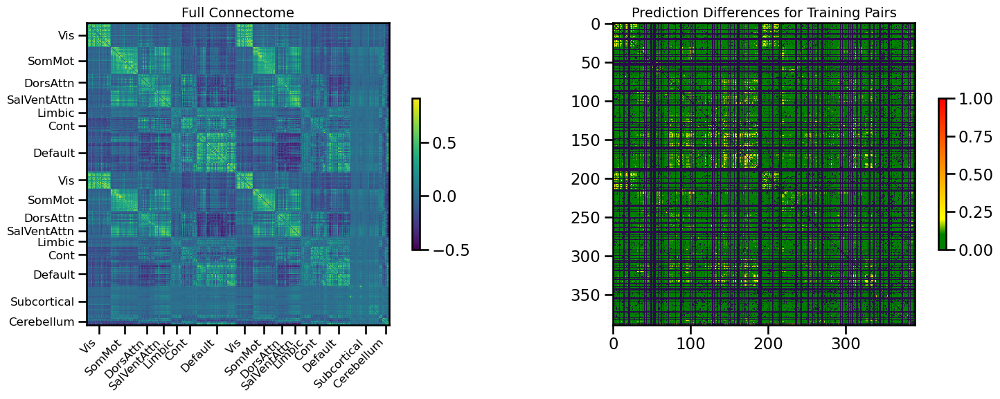

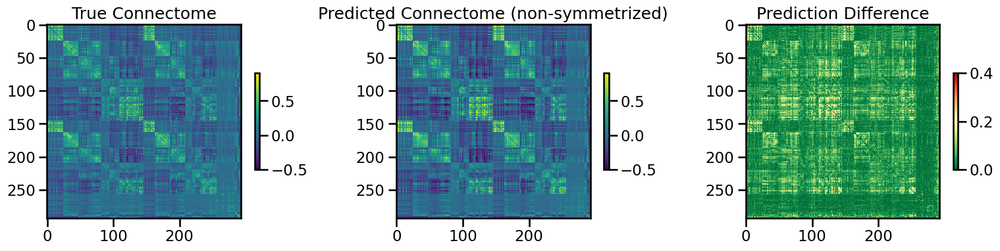

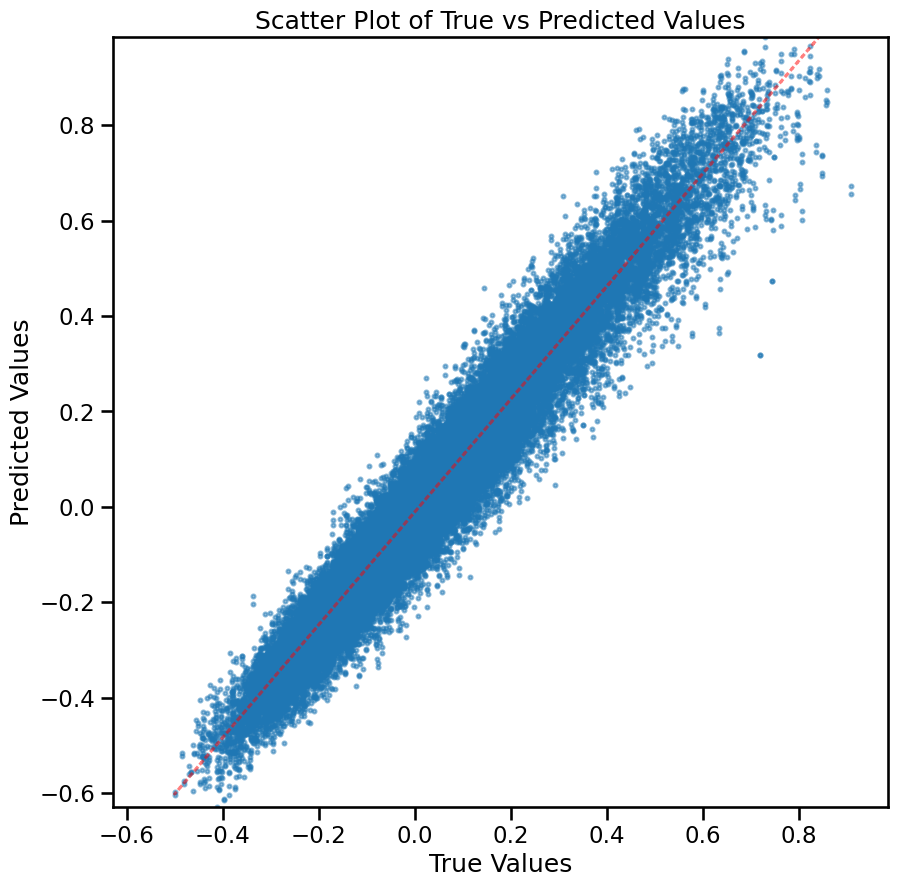

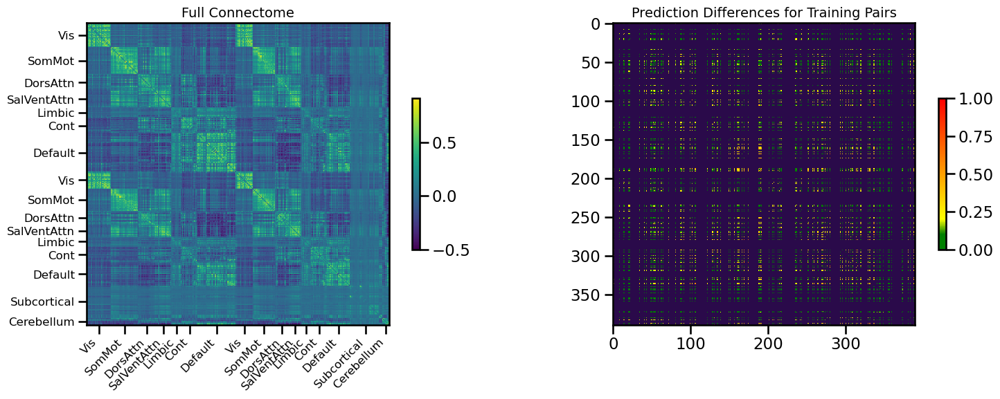

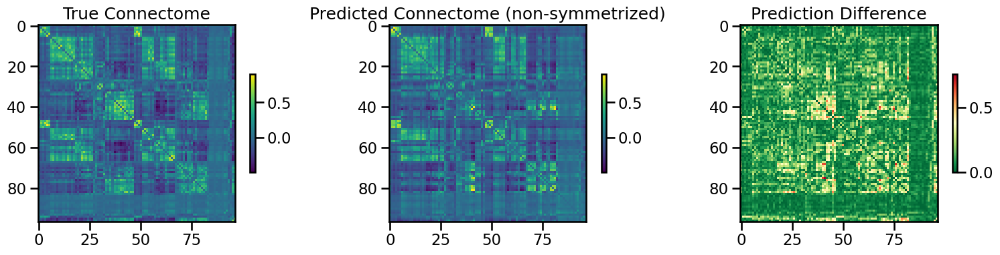

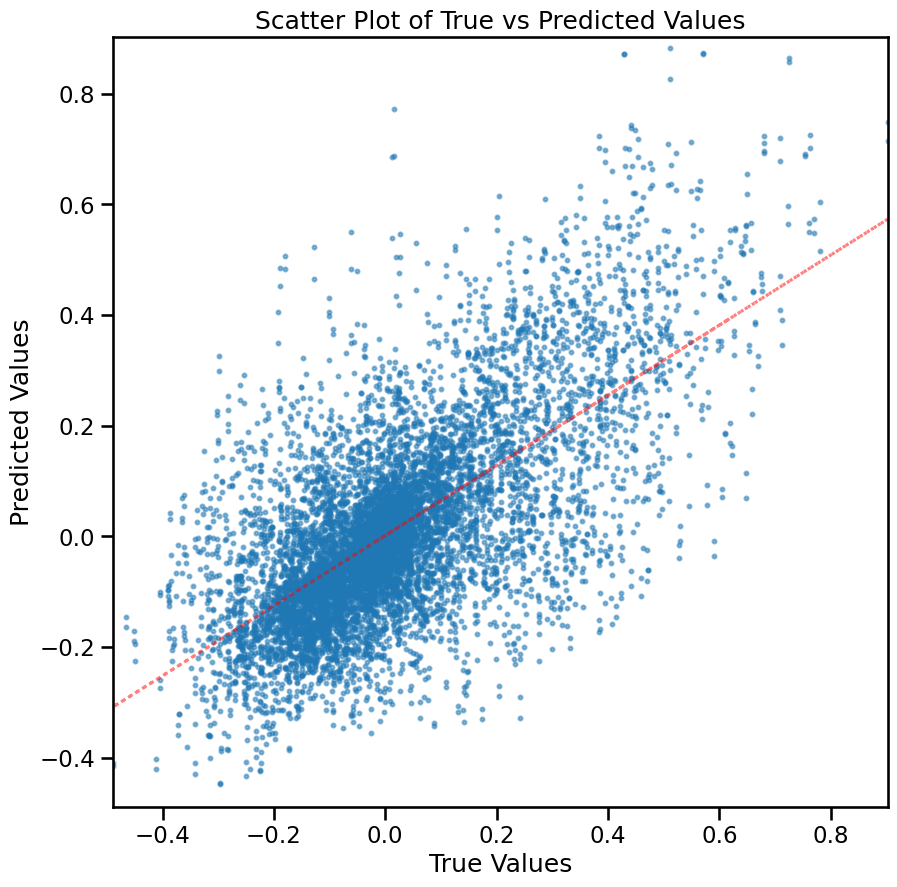


TRAIN METRICS: {'mse': 0.0037505778, 'mae': 0.04519143, 'r2': 0.8815367248057104, 'pearson_corr': 0.9714052519440486, 'geodesic_distance': 13.87780612725207}
TEST METRICS: {'mse': 0.022055428, 'mae': 0.10610492, 'r2': 0.37923641626144255, 'pearson_corr': 0.6726642174697999, 'geodesic_distance': 11.447874381915025}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'use_positional_encoding': False, 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}
CPU Usage: 18.0%
RAM Usage: 12.5%
Available RAM: 881.3G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  7% |


57032

In [15]:
# Run simulation
single_sim_run(
              cv_type='random',
              random_seed=42,
              model_type='shared_transformer_cls',
              feature_type=[{'transcriptome': None}],
              connectome_target='FC',
              binarize=False,
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 3),
              save_sim=False,
              track_wandb=False,
              skip_cv=True
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()